In [1]:
# Librairies personnalisées
from my_functions.common_functions import *
from my_functions.uni_bi_variate_functions import *
from my_functions.machine_learning_common_functions import *
from my_functions.dimensionality_reduction_functions import *

from sklearn.manifold import TSNE, Isomap
%matplotlib inline
# for creating a responsive plot
%matplotlib widget

low_memory=False # faible mémoire vive (RAM) pour gérer la lecture de gros fichiers

# Data Load & Merge

## Customers

In [2]:
# Chargement des Data Sets
customers = pd.read_csv('olist_customers_dataset.csv', low_memory=low_memory)

In [3]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


Le data set contient :
	- 99441 lignes et 5 colonnes.
	- 0 valeurs manquantes, ce qui représente 0.0 % du data set.
Voici un sous-échantillon aléatoire :


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
79414,aa3e8d6f20aeba10bbf8952efa49894a,0166e2f8aaec14c93d23dea2523beac5,17400,garca,SP
74022,9c9da709db4d73a4b732e11026252c3c,0c45dff0741b5a083effb76c24e8c3bd,13025,campinas,SP


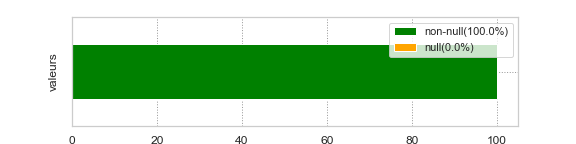

In [4]:
verifier_taille(customers)
afficher_echantillon(customers)

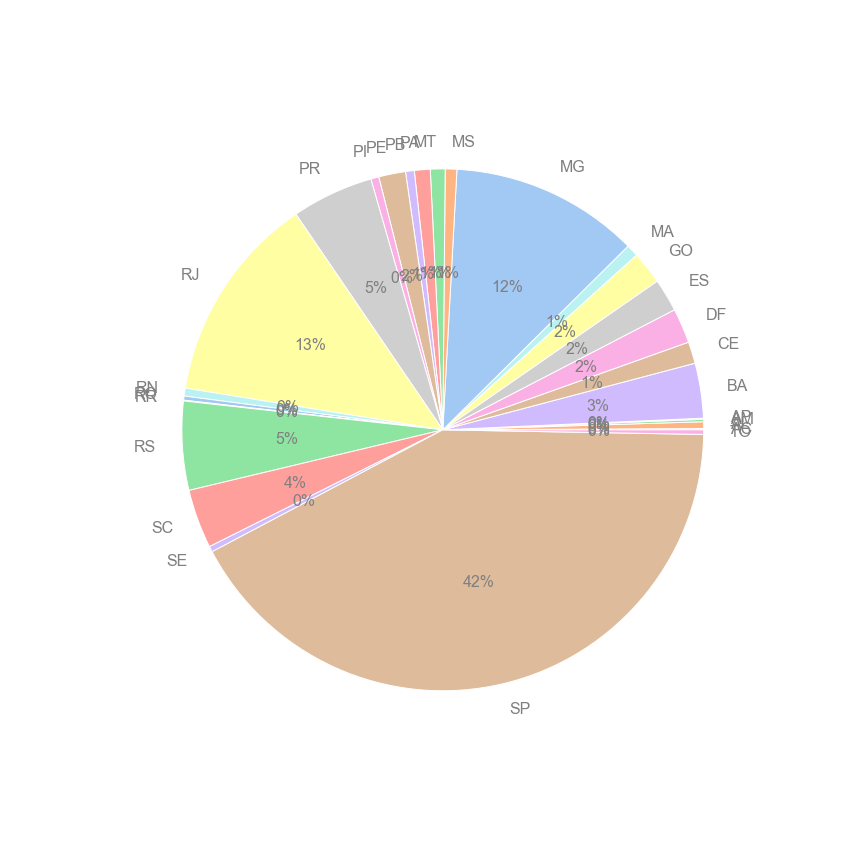

In [5]:
states = customers.groupby('customer_state').count()['customer_unique_id']

colors = sns.color_palette('pastel')
fig, ax = plt.subplots(figsize=(12, 12))
plt.pie(states, labels=states.index.tolist(), colors = colors, autopct = '%0.0f%%', textprops = {'color': 'Gray','fontsize':16})
plt.show()

In [6]:
states.sort_values(ascending=False).iloc[:5].index

Index(['SP', 'RJ', 'MG', 'RS', 'PR'], dtype='object', name='customer_state')

In [7]:
customers.loc[~customers['customer_state'].isin(states.sort_values(ascending=False).iloc[:5].index), 'customer_state']='other'
customers

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,other
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS


In [8]:
all_customers = customers.groupby('customer_unique_id').count().sort_values(by='customer_id',ascending=False)
all_customers

,customer_id,customer_zip_code_prefix,customer_city,customer_state
customer_unique_id,,,,
8d50f5eadf50201ccdcedfb9e2ac8455,17,17,17,17
3e43e6105506432c953e165fb2acf44c,9,9,9,9
6469f99c1f9dfae7733b25662e7f1782,7,7,7,7
ca77025e7201e3b30c44b472ff346268,7,7,7,7
1b6c7548a2a1f9037c1fd3ddfed95f33,7,7,7,7
...,...,...,...,...
5657dfebff5868c4dc7e8355fea865c4,1,1,1,1
5657596addb4d7b07b32cd330614bdf8,1,1,1,1
5656eb169546146caeab56c3ffc3d268,1,1,1,1


In [9]:
frequent_customers = all_customers[all_customers['customer_id']>1]
frequent_customers

,customer_id,customer_zip_code_prefix,customer_city,customer_state
customer_unique_id,,,,
8d50f5eadf50201ccdcedfb9e2ac8455,17,17,17,17
3e43e6105506432c953e165fb2acf44c,9,9,9,9
6469f99c1f9dfae7733b25662e7f1782,7,7,7,7
ca77025e7201e3b30c44b472ff346268,7,7,7,7
1b6c7548a2a1f9037c1fd3ddfed95f33,7,7,7,7
...,...,...,...,...
5cfc9643603c095fd7ed86a50fa17887,2,2,2,2
cfb025f193db116549c9c23e4d58e3e3,2,2,2,2
609b7feab0f0c9726929ec4891447b02,2,2,2,2


In [10]:
print(round(len(frequent_customers)/len(all_customers)*100, 2), '% des cliens ont passées plus d\'une commande')

3.12 % des cliens ont passées plus d'une commande


## Orders

In [11]:
orders = pd.read_csv('olist_orders_dataset.csv', low_memory=low_memory)
orders

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00


In [12]:
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'], infer_datetime_format=True)

In [13]:
orders.order_status.unique()

array(['delivered', 'invoiced', 'shipped', 'processing', 'unavailable',
       'canceled', 'created', 'approved'], dtype=object)

In [14]:
orders[orders['order_status']!='delivered']

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00
44,ee64d42b8cf066f35eac1cf57de1aa85,caded193e8e47b8362864762a83db3c5,shipped,2018-06-04 16:44:48,2018-06-05 04:31:18,2018-06-05 14:32:00,NaN,2018-06-28 00:00:00
103,0760a852e4e9d89eb77bf631eaaf1c84,d2a79636084590b7465af8ab374a8cf5,invoiced,2018-08-03 17:44:42,2018-08-07 06:15:14,NaN,NaN,2018-08-21 00:00:00
128,15bed8e2fec7fdbadb186b57c46c92f2,f3f0e613e0bdb9c7cee75504f0f90679,processing,2017-09-03 14:22:03,2017-09-03 14:30:09,NaN,NaN,2017-10-03 00:00:00
154,6942b8da583c2f9957e990d028607019,52006a9383bf149a4fb24226b173106f,shipped,2018-01-10 11:33:07,2018-01-11 02:32:30,2018-01-11 19:39:23,NaN,2018-02-07 00:00:00
...,...,...,...,...,...,...,...,...
99283,3a3cddda5a7c27851bd96c3313412840,0b0d6095c5555fe083844281f6b093bb,canceled,2018-08-31 16:13:44,NaN,NaN,NaN,2018-10-01 00:00:00
99313,e9e64a17afa9653aacf2616d94c005b8,b4cd0522e632e481f8eaf766a2646e86,processing,2018-01-05 23:07:24,2018-01-09 07:18:05,NaN,NaN,2018-02-06 00:00:00
99347,a89abace0dcc01eeb267a9660b5ac126,2f0524a7b1b3845a1a57fcf3910c4333,canceled,2018-09-06 18:45:47,NaN,NaN,NaN,2018-09-27 00:00:00
99348,a69ba794cc7deb415c3e15a0a3877e69,726f0894b5becdf952ea537d5266e543,unavailable,2017-08-23 16:28:04,2017-08-28 15:44:47,NaN,NaN,2017-09-15 00:00:00


In [15]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_approved_at              99281 non-null  object        
 5   order_delivered_carrier_date   97658 non-null  object        
 6   order_delivered_customer_date  96476 non-null  object        
 7   order_estimated_delivery_date  99441 non-null  object        
dtypes: datetime64[ns](1), object(7)
memory usage: 6.1+ MB


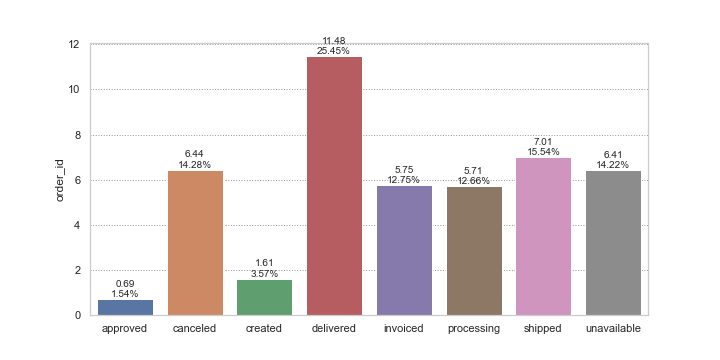

In [16]:
status = orders.groupby('order_status').count()['order_id']
status = np.log(status)

fig, ax = plt.subplots(figsize=(10, 5))
sns.barplot(x=status.index.tolist(), y=status)
for i in ax.containers:
    ax.bar_label(i, labels=[str(round(i.datavalues[j],2))+'\n'+str(round(i.datavalues[j]/(sum(i.datavalues))*100, 2))+'%' for j in range(len(i))])
plt.show()

In [17]:
# Garder uniquement les commandes livrées
orders = orders[orders['order_status']=='delivered']

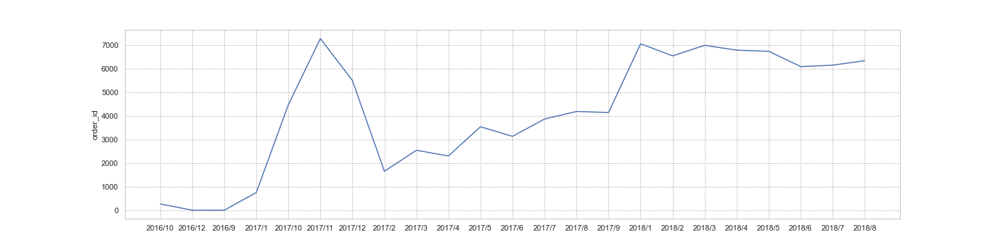

In [18]:
# Fréquence d'achats dans le temps
orders = orders[['customer_id', 'order_id', 'order_purchase_timestamp']]

orders['time'] = orders['order_purchase_timestamp'].apply(lambda x: str(x.year)+'/'+str(x.month))
orders_time = orders.groupby('time').count()['order_id']
orders = orders.drop(columns='time')

fig, ax = plt.subplots(figsize=(20, 5))
sns.lineplot(x=orders_time.index.tolist(), y=orders_time)
plt.show()

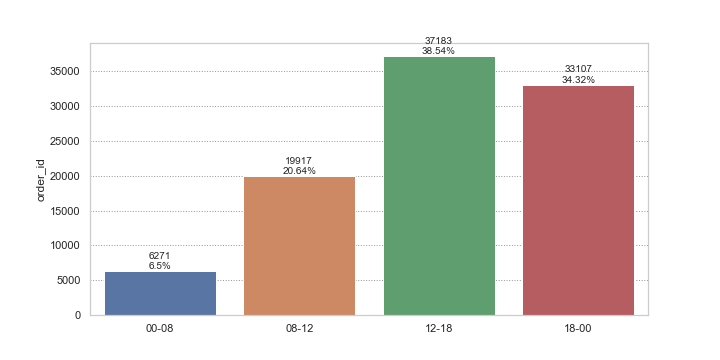

In [19]:
# Fréquence d'achats par moments du jour
orders['daytime'] = orders['order_purchase_timestamp'].dt.hour
orders['daytime'] = orders['daytime'].apply(lambda x : 0 if x>=0 and x <8 else 1 if x<12 else 2 if x<18 else 4)
orders_daytime = orders.groupby('daytime').count()['order_id']

fig, ax = plt.subplots(figsize=(10, 5))
sns.barplot(x=['00-08', '08-12', '12-18', '18-00'], y=orders_daytime)
for i in ax.containers:
    ax.bar_label(i, labels=[str(int(i.datavalues[j]))+'\n'+str(round(i.datavalues[j]/(sum(i.datavalues))*100, 2))+'%' for j in range(len(i))])
plt.show()

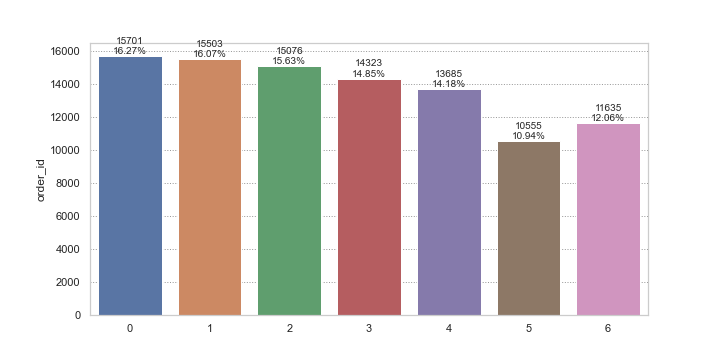

In [20]:
# Fréquence d'achats par jour de semaine
orders['weekday'] = orders['order_purchase_timestamp'].dt.weekday
orders_weekday= orders.groupby('weekday').count()['order_id']

fig, ax = plt.subplots(figsize=(10, 5))
sns.barplot(x=orders_weekday.index.tolist(), y=orders_weekday)
for i in ax.containers:
    ax.bar_label(i, labels=[str(int(i.datavalues[j]))+'\n'+str(round(i.datavalues[j]/(sum(i.datavalues))*100, 2))+'%' for j in range(len(i))])
plt.show()

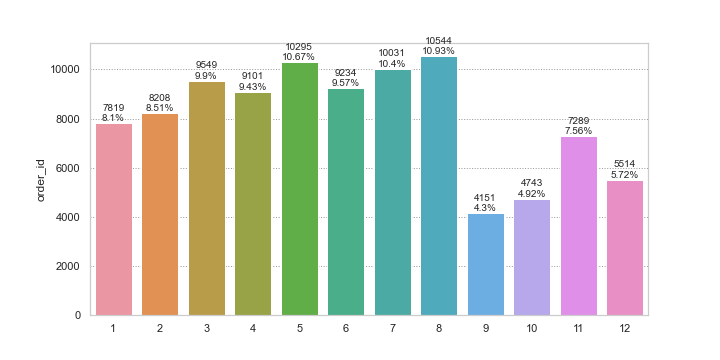

In [21]:
# Fréquence d'achats par mois de l'année
orders['month'] = orders['order_purchase_timestamp'].dt.month
orders_month= orders.groupby('month').count()['order_id']

fig, ax = plt.subplots(figsize=(10, 5))
sns.barplot(x=orders_month.index.tolist(), y=orders_month)
for i in ax.containers:
    ax.bar_label(i, labels=[str(int(i.datavalues[j]))+'\n'+str(round(i.datavalues[j]/(sum(i.datavalues))*100, 2))+'%' for j in range(len(i))])
plt.show()

p-value is:  4.233030316360296e-160
chi=808.810731, critical value=28.869299
At 0.05 level of significance, we reject the null hypotheses and accept H1. 
    They are not independent.


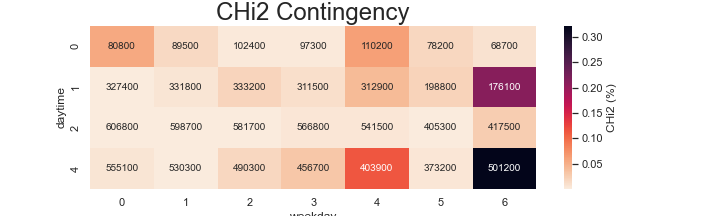

In [22]:
chi2(orders, 'daytime', 'weekday', heigth=3, width=10)

## df = Customers x Orders

In [23]:
df = pd.merge(customers[['customer_unique_id', 'customer_id', 'customer_state']], orders, how='inner', on=['customer_id']).drop(columns='customer_id')
print('Doublons :', len(doublons(df['order_id'])))
df

Doublons : 0


,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month
0,861eff4711a542e4b93843c6dd7febb0,SP,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2,1,5
1,290c77bc529b7ac935b93aa66c333dc3,SP,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,4,4,1
2,060e732b5b29e8181a18229c7b0b2b5e,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2,5,5
3,259dac757896d24d7702b9acbbff3f3c,SP,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2,1,3
4,345ecd01c38d18a9036ed96c73b8d066,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,6,7
...,...,...,...,...,...,...,...
96473,1a29b476fee25c95fbafc67c5ac95cf8,SP,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2,5,4
96474,d52a67c98be1cf6a5c84435bd38d095d,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,1,2,4
96475,e9f50caf99f032f0bf3c55141f019d99,other,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,4,6,4
96476,73c2643a0a458b49f58cea58833b192e,RS,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,4,4,11


In [24]:
nb_orders = df.groupby(['customer_unique_id']).count().reset_index(level=0).sort_values(by='order_id', ascending=False)
nb_orders

,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month
51431,8d50f5eadf50201ccdcedfb9e2ac8455,15,15,15,15,15,15
22779,3e43e6105506432c953e165fb2acf44c,9,9,9,9,9,9
36706,6469f99c1f9dfae7733b25662e7f1782,7,7,7,7,7,7
73921,ca77025e7201e3b30c44b472ff346268,7,7,7,7,7,7
10060,1b6c7548a2a1f9037c1fd3ddfed95f33,7,7,7,7,7,7
...,...,...,...,...,...,...,...
31564,565811ed44e539a14bc391cf57373ed1,1,1,1,1,1,1
31563,5657f9f721c16800a66c21081d46b18d,1,1,1,1,1,1
31562,5657dfebff5868c4dc7e8355fea865c4,1,1,1,1,1,1
31561,5657596addb4d7b07b32cd330614bdf8,1,1,1,1,1,1


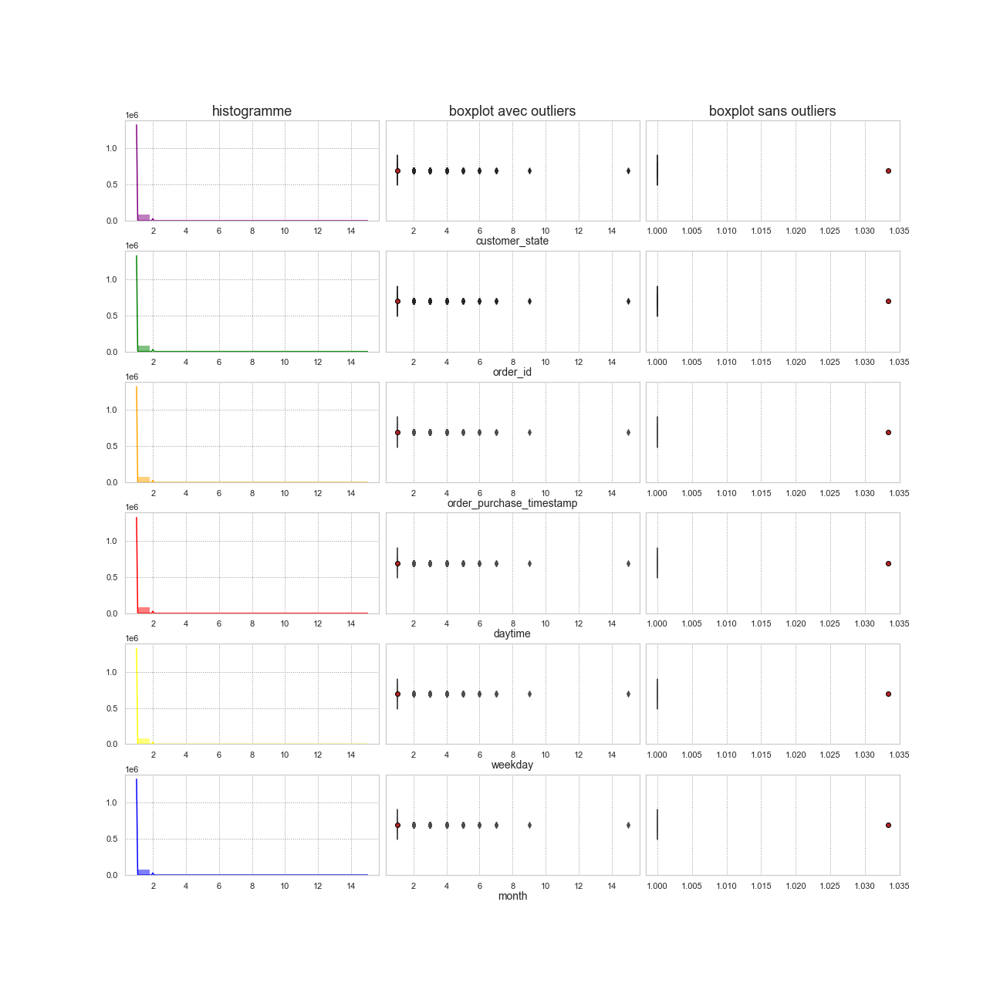

In [25]:
histo_distribution(nb_orders)

## Orders Items

In [26]:
order_items = pd.read_csv('olist_order_items_dataset.csv', low_memory=low_memory)
order_items

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [27]:
# Volime des commandes
orders_volume = order_items[['order_id', 'product_id', 'order_item_id']].groupby(['order_id', 'product_id']).max().reset_index(level=0)
orders_volume = orders_volume[['order_id', 'order_item_id']].groupby(['order_id']).sum().reset_index(level=0)
orders_volume = renameCol(orders_volume, 'order_item_id', 'orders_volume')
orders_volume.sort_values(by='orders_volume', ascending=False)

,order_id,orders_volume
50137,8272b63d03f5f79c56e9e4120aec44ef,52
77909,ca3625898fbd48669d50701aba51cd5f,43
34716,5a3b1c29a49756e75f1ef513383c0c12,41
38273,637617b3ffe9e2f7a2411243829226d0,31
66653,ad850e69fce9a512ada84086651a2e7d,28
...,...,...
34640,5a0911d70c1f85d3bed0df1bf693a6dd,1
34639,5a082b558a3798d3e36d93bfa8ca1eae,1
34637,5a07264682e0b8fbb3f166edbbffc6e8,1
34636,5a071192a28951b76774e5a760c8c9b7,1


In [28]:
products = pd.read_csv('olist_products_dataset.csv', low_memory=low_memory)
products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [29]:
nan_cols(products)

,Column,#NaN,%NaN,#Not_NaN,%Not_NaN
0,product_id,0,0.00,32951,100.00
1,product_category_name,610,1.85,32341,98.15
2,product_name_lenght,610,1.85,32341,98.15
3,product_description_lenght,610,1.85,32341,98.15
4,product_photos_qty,610,1.85,32341,98.15
5,product_weight_g,2,0.01,32949,99.99
6,product_length_cm,2,0.01,32949,99.99
7,product_height_cm,2,0.01,32949,99.99
8,product_width_cm,2,0.01,32949,99.99


In [30]:
products = products[products['product_category_name'].notna()]

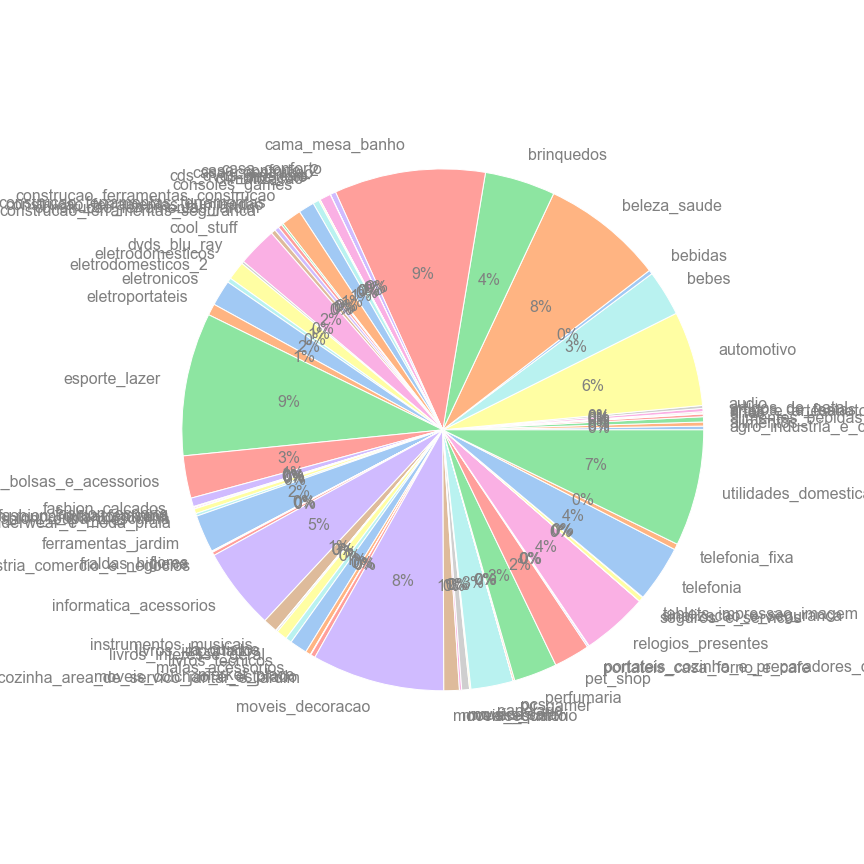

In [31]:
# Le nombre de produits par catégorie
products_categ= products.groupby('product_category_name').count()['product_id']

colors = sns.color_palette('pastel')
fig, ax = plt.subplots(figsize=(12, 12))
plt.pie(products_categ, labels=products_categ.index.tolist(), colors = colors, autopct = '%0.0f%%', textprops = {'color': 'Gray','fontsize':16})
plt.show()

In [32]:
order_items = pd.merge(order_items, products[['product_id', 'product_category_name']], how='inner', on=['product_id'])
order_items

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,cool_stuff
1,130898c0987d1801452a8ed92a670612,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-07-05 02:44:11,55.9,17.96,cool_stuff
2,532ed5e14e24ae1f0d735b91524b98b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2018-05-23 10:56:25,64.9,18.33,cool_stuff
3,6f8c31653edb8c83e1a739408b5ff750,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-08-07 18:55:08,58.9,16.17,cool_stuff
4,7d19f4ef4d04461989632411b7e588b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-08-16 22:05:11,58.9,13.29,cool_stuff
...,...,...,...,...,...,...,...,...
111042,ffebd80e3291e811c308365936897efd,1,4cc4d02efc8f249c13355147fb44e34d,d1c7fa84e48cfa21a0e595167c1c500e,2018-07-18 20:23:55,129.9,51.20,ferramentas_jardim
111043,ffee31fb4b5e35c9123608015637c495,1,b10ecf8e33aaaea419a9fa860ea80fb5,0241d4d5d36f10f80c644447315af0bd,2018-08-21 10:10:11,99.0,13.52,moveis_decoracao
111044,fff7c4452f050315db1b3f24d9df5fcd,1,dd469c03ad67e201bc2179ef077dcd48,7e93a43ef30c4f03f38b393420bc753a,2017-06-07 17:05:23,736.0,20.91,relogios_presentes
111045,fffa82886406ccf10c7b4e35c4ff2788,1,bbe7651fef80287a816ead73f065fc4b,8f2ce03f928b567e3d56181ae20ae952,2017-12-22 17:31:42,229.9,44.02,esporte_lazer


In [33]:
order_items[order_items['order_id'].isin(order_items[order_items['order_item_id']>1]['order_id'])].sort_values(by=['order_id', 'order_item_id']).tail(20)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name
75966,ffc16cecff8dc037f60458f28d1c1ba5,1,241e398aacc909372622952b2ec6f954,de23c3b98a88888289c6f5cc1209054a,2017-11-27 19:34:24,179.90,10.03,papelaria
58543,ffc16cecff8dc037f60458f28d1c1ba5,2,7c1043bb5837db0c6bc1953419a18628,de23c3b98a88888289c6f5cc1209054a,2017-11-27 19:34:24,169.90,10.04,papelaria
66857,ffd543c2b60842e148a86870dc60e212,1,3ce943997ff85cad84ec6770b35d6bcd,9c0e69c7bf2619675bbadf47b43f655a,2018-01-11 02:35:33,175.90,7.15,informatica_acessorios
8068,ffd543c2b60842e148a86870dc60e212,2,b7d94dc0640c7025dc8e3b46b52d8239,9c0e69c7bf2619675bbadf47b43f655a,2018-01-11 02:35:33,175.91,14.15,informatica_acessorios
111031,ffd6f465cab015b452d398ac1f5d978a,1,fdcf45aa23bb8312ecc0027d6e1ef1c4,113e3a788b935f48aad63e1c41dac1bd,2018-05-03 09:30:37,7.84,22.06,artigos_de_natal
111032,ffd6f465cab015b452d398ac1f5d978a,2,fdcf45aa23bb8312ecc0027d6e1ef1c4,113e3a788b935f48aad63e1c41dac1bd,2018-05-03 09:30:37,7.84,22.06,artigos_de_natal
111033,ffd6f465cab015b452d398ac1f5d978a,3,fdcf45aa23bb8312ecc0027d6e1ef1c4,113e3a788b935f48aad63e1c41dac1bd,2018-05-03 09:30:37,7.84,22.06,artigos_de_natal
45093,ffd84ab39cd5e873d8dba24342e65c01,1,fcf50ee5ad1f1a48671052487d2b0bff,0be8ff43f22e456b4e0371b2245e4d01,2017-10-11 19:49:17,24.90,7.78,informatica_acessorios
45094,ffd84ab39cd5e873d8dba24342e65c01,2,fcf50ee5ad1f1a48671052487d2b0bff,0be8ff43f22e456b4e0371b2245e4d01,2017-10-11 19:49:17,24.90,7.78,informatica_acessorios
111038,ffe4b41e99d39f0b837a239110260530,1,e97df839917a6e93404867b1d0319bfc,42bde9fef835393bb8a8849cb6b7f245,2017-09-07 21:25:40,19.00,15.79,brinquedos


Sum the prices

In [34]:
order_prices = order_items[['order_id','price', 'freight_value']].groupby('order_id').sum().reset_index(level=0)
order_prices = pd.merge(order_prices, order_items.loc[order_items['order_item_id']==1,['order_id', 'product_category_name']], how='inner', on=['order_id'])
order_prices.sort_values(by='price', ascending=False)

,order_id,price,freight_value,product_category_name
1432,03caa2c082116e1d31e67e9ae3700499,13440.00,224.08,telefonia_fixa
43827,736e1922ae60d0d6a89247b851902527,7160.00,114.88,telefonia_fixa
3087,0812eb902a67711a1cb742b3cdaa65ae,6735.00,194.31,utilidades_domesticas
96887,fefacc66af859508bf1a7934eab1e97f,6729.00,193.21,pcs
93081,f5136e38d1a14a4dbd87dff67da82701,6499.00,227.66,artes
...,...,...,...,...
21475,38bcb524e1c38c2c1b60600a80fc8999,2.90,8.72,pet_shop
88475,e8bbc1d69fee39eee4c72cb5c969e39d,2.29,7.78,papelaria
91871,f1d5c2e6867fa93ceee9ef9b34a53cbf,2.20,7.39,beleza_saude
41956,6e864b3f0ec71031117ad4cf46b7f2a1,0.85,18.23,construcao_ferramentas_construcao


In [35]:
order_items[order_items['order_id']=='f5136e38d1a14a4dbd87dff67da82701']

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name
110150,f5136e38d1a14a4dbd87dff67da82701,1,1bdf5e6731585cf01aa8169c7028d6ad,ee27a8f15b1dded4d213a468ba4eb391,2017-06-15 02:45:17,6499.0,227.66,artes


## df = Customers x Orders x Orders Prices x Orders Volumes

In [36]:
df = pd.merge(df, order_prices, how='inner', on=['order_id'])
df = pd.merge(df, orders_volume, how='inner', on=['order_id'])
print('Doublons :', len(doublons(df['order_id'])))
df

Doublons : 0


,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,price,freight_value,product_category_name,orders_volume
0,861eff4711a542e4b93843c6dd7febb0,SP,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2,1,5,124.99,21.88,moveis_escritorio,1
1,290c77bc529b7ac935b93aa66c333dc3,SP,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,4,4,1,289.00,46.48,utilidades_domesticas,1
2,060e732b5b29e8181a18229c7b0b2b5e,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2,5,5,139.94,17.79,moveis_escritorio,1
3,259dac757896d24d7702b9acbbff3f3c,SP,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2,1,3,149.94,23.36,moveis_escritorio,1
4,345ecd01c38d18a9036ed96c73b8d066,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,6,7,230.00,22.25,casa_conforto,1
...,...,...,...,...,...,...,...,...,...,...,...
95114,1a29b476fee25c95fbafc67c5ac95cf8,SP,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2,5,4,74.90,13.88,livros_interesse_geral,1
95115,d52a67c98be1cf6a5c84435bd38d095d,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,1,2,4,114.90,14.16,esporte_lazer,1
95116,e9f50caf99f032f0bf3c55141f019d99,other,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,4,6,4,37.00,19.04,beleza_saude,1
95117,73c2643a0a458b49f58cea58833b192e,RS,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,4,4,11,689.00,22.07,relogios_presentes,1


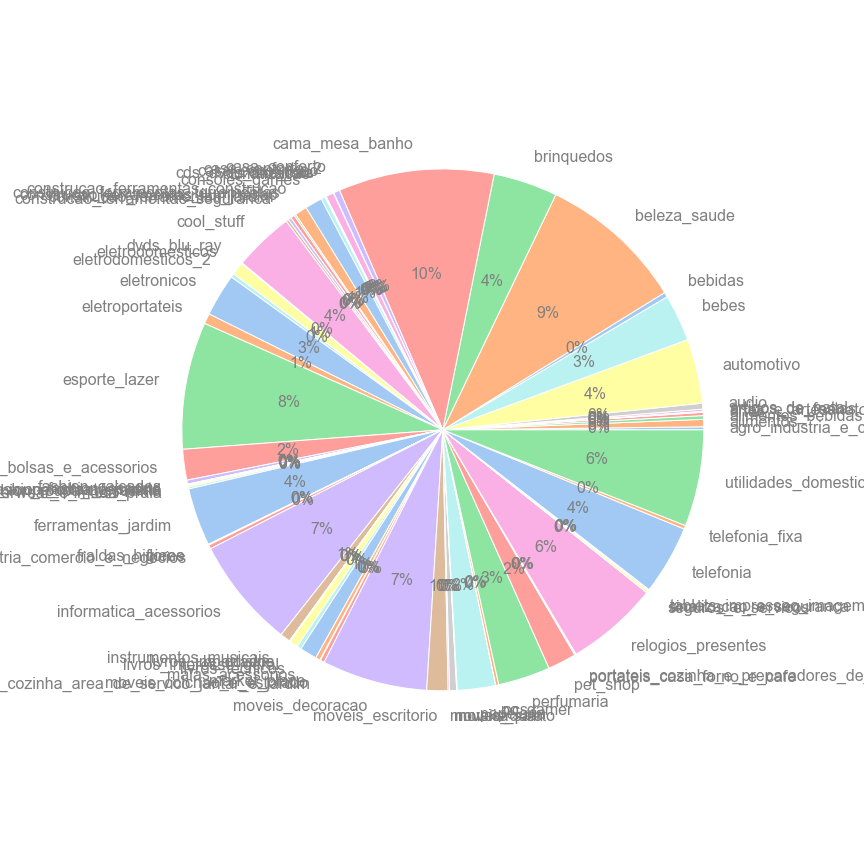

In [37]:
# Le nombre de commandes par catégorie
orders_categ= df.groupby('product_category_name').count()['customer_unique_id']

colors = sns.color_palette('pastel')
fig, ax = plt.subplots(figsize=(12, 12))
plt.pie(orders_categ, labels=orders_categ.index.tolist(), colors = colors, autopct = '%0.0f%%', textprops = {'color': 'Gray','fontsize':16})
plt.show()

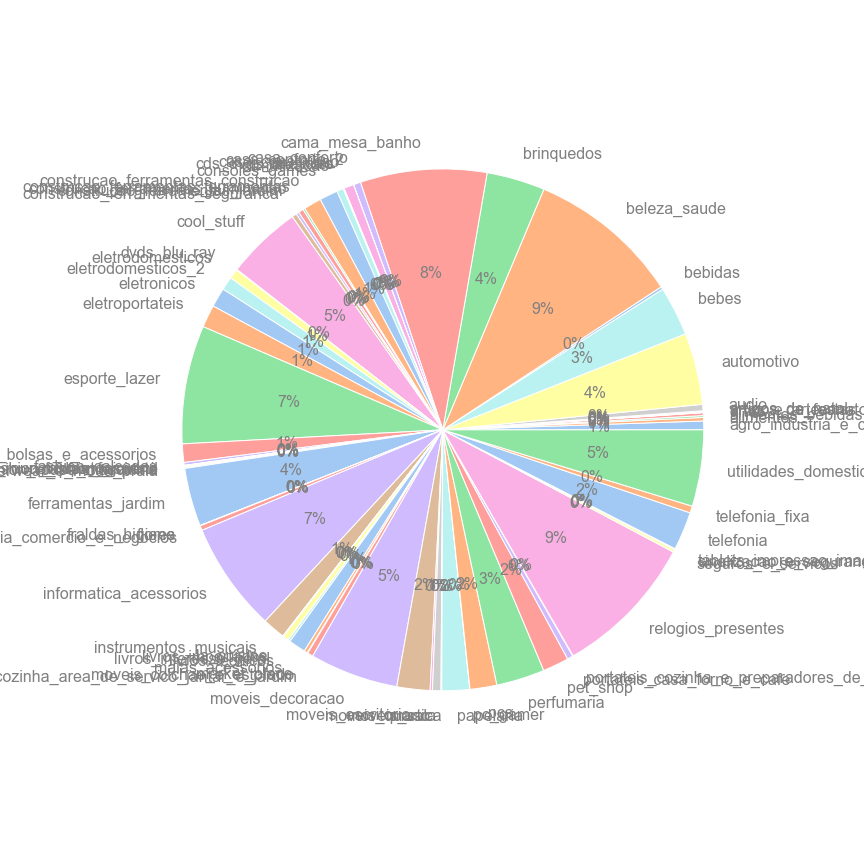

In [38]:
# Le montant total des commandes par catégorie
orders_categ= df.groupby('product_category_name').sum()['price']

colors = sns.color_palette('pastel')
fig, ax = plt.subplots(figsize=(12, 12))
plt.pie(orders_categ, labels=orders_categ.index.tolist(), colors = colors, autopct = '%0.0f%%', textprops = {'color': 'Gray','fontsize':16})
plt.show()

## Orders Payments

In [39]:
order_payments = pd.read_csv('olist_order_payments_dataset.csv', low_memory=low_memory)
order_payments#sort_values(by='payment_sequential', ascending=False)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45
...,...,...,...,...,...
103881,0406037ad97740d563a178ecc7a2075c,1,boleto,1,363.31
103882,7b905861d7c825891d6347454ea7863f,1,credit_card,2,96.80
103883,32609bbb3dd69b3c066a6860554a77bf,1,credit_card,1,47.77
103884,b8b61059626efa996a60be9bb9320e10,1,credit_card,5,369.54


In [40]:
order_payments.groupby('order_id').sum().sort_values(by='payment_value', ascending=False)

,payment_sequential,payment_installments,payment_value
order_id,,,
03caa2c082116e1d31e67e9ae3700499,1,1,13664.08
736e1922ae60d0d6a89247b851902527,1,1,7274.88
0812eb902a67711a1cb742b3cdaa65ae,1,8,6929.31
fefacc66af859508bf1a7934eab1e97f,1,1,6922.21
f5136e38d1a14a4dbd87dff67da82701,1,1,6726.66
...,...,...,...
e8bbc1d69fee39eee4c72cb5c969e39d,1,1,10.07
f1d5c2e6867fa93ceee9ef9b34a53cbf,3,2,9.59
c8c528189310eaa44a745b8d9d26908b,1,1,0.00


In [41]:
order_payments[order_payments['payment_sequential']>1].sort_values(by=['order_id', 'payment_sequential'], ascending=False).head(10)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
28537,ffc730a0615d28ec19f9cad02cb41442,2,credit_card,1,12.63
3009,ffa39020fe7c8a3e907320e1bec4b985,2,voucher,1,64.01
21648,ffa1dd97810de91a03abd7bd76d2fed1,2,voucher,1,418.73
11583,ff978de32e717acd3b5abe1fb069d2b6,4,voucher,1,7.68
28611,ff978de32e717acd3b5abe1fb069d2b6,3,voucher,1,0.66
26914,ff978de32e717acd3b5abe1fb069d2b6,2,voucher,1,10.80
96028,ff7400d904161b62b6e830b3988f5cbd,2,voucher,1,100.00
24664,ff20ee702706d9e407a34de9fe2ff768,2,voucher,1,50.00
95767,ff1f8f328e5a59ac754240b6dd31bcb4,4,voucher,1,26.03
75488,ff1f8f328e5a59ac754240b6dd31bcb4,3,voucher,1,142.58


In [42]:
order_payments[order_payments['order_id']=='ff978de32e717acd3b5abe1fb069d2b6']

,order_id,payment_sequential,payment_type,payment_installments,payment_value
11583,ff978de32e717acd3b5abe1fb069d2b6,4,voucher,1,7.68
26914,ff978de32e717acd3b5abe1fb069d2b6,2,voucher,1,10.80
28611,ff978de32e717acd3b5abe1fb069d2b6,3,voucher,1,0.66
46828,ff978de32e717acd3b5abe1fb069d2b6,1,voucher,1,30.00


In [43]:
df[df['order_id']=='ff978de32e717acd3b5abe1fb069d2b6']

,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,price,freight_value,product_category_name,orders_volume
34063,7e1ca53dbea2514cb38bb0de60e8f16b,other,ff978de32e717acd3b5abe1fb069d2b6,2017-12-12 09:50:42,1,1,12,27.99,21.15,informatica_acessorios,1


## Payments

In [44]:
payments = order_payments[['order_id', 'payment_sequential', 'payment_installments', 'payment_value']].groupby('order_id').agg({'payment_sequential':'max', 'payment_installments': 'max', 'payment_value': 'sum'}).reset_index(level=0)
payments.sort_values('payment_sequential', ascending=False)

,order_id,payment_sequential,payment_installments,payment_value
97261,fa65dad1b0e818e3ccc5cb0e39231352,29,1,457.99
79611,ccf804e764ed5650cd8759557269dc13,26,1,62.68
15577,285c2e15bebd4ac83635ccc563dc71f4,22,1,40.85
53168,895ab968e7bb0d5659d16cd74cd1650c,21,1,161.32
92724,ee9ca989fc93ba09a6eddc250ce01742,19,1,82.73
...,...,...,...,...
33713,56ca2955a23551796d37da2e384c7139,1,1,30.10
33712,56c9b97f31031c70ffb000219dc6f403,1,8,163.81
33711,56c93a3f93a1e7eb24ed51a6931dc488,1,1,933.70
33710,56c898abec8a6fd5e84ffc42904c4f65,1,10,478.33


In [45]:
payments[payments['order_id']=='ff978de32e717acd3b5abe1fb069d2b6']

,order_id,payment_sequential,payment_installments,payment_value
99293,ff978de32e717acd3b5abe1fb069d2b6,4,1,49.14


## Payements Type

In [46]:
payment_type = order_payments[['order_id','payment_type']].drop_duplicates(subset='order_id')
payment_type

,order_id,payment_type
0,b81ef226f3fe1789b1e8b2acac839d17,credit_card
1,a9810da82917af2d9aefd1278f1dcfa0,credit_card
2,25e8ea4e93396b6fa0d3dd708e76c1bd,credit_card
3,ba78997921bbcdc1373bb41e913ab953,credit_card
4,42fdf880ba16b47b59251dd489d4441a,credit_card
...,...,...
103881,0406037ad97740d563a178ecc7a2075c,boleto
103882,7b905861d7c825891d6347454ea7863f,credit_card
103883,32609bbb3dd69b3c066a6860554a77bf,credit_card
103884,b8b61059626efa996a60be9bb9320e10,credit_card


In [47]:
payment_type['payment_type'].unique()

array(['credit_card', 'boleto', 'voucher', 'debit_card', 'not_defined'],
      dtype=object)

In [48]:
payment_type[payment_type['payment_type']=='not_defined']

,order_id,payment_type
51280,4637ca194b6387e2d538dc89b124b0ee,not_defined
57411,00b1cb0320190ca0daa2c88b35206009,not_defined
94427,c8c528189310eaa44a745b8d9d26908b,not_defined


In [49]:
payment_type = payment_type[payment_type['payment_type']!='not_defined']

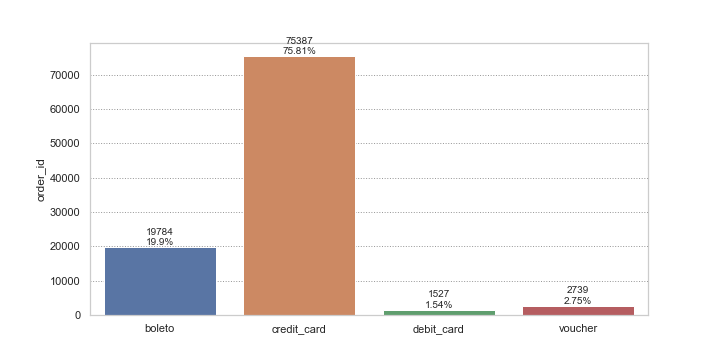

In [50]:
ptypes = payment_type.groupby('payment_type').count()['order_id']
ptypes_name = ptypes.index.tolist()

colors = sns.color_palette('pastel')
fig, ax = plt.subplots(figsize=(10, 5))
sns.barplot(x=ptypes_name, y=ptypes)
for i in ax.containers:
    ax.bar_label(i, labels=[str(int(i.datavalues[j]))+'\n'+str(round(i.datavalues[j]/(sum(i.datavalues))*100, 2))+'%' for j in range(len(i))])
plt.show()

## df = Customers x Orders x Orders Prices x Payements x Payements Type

In [51]:
df = pd.merge(df, payments, how='inner', on=['order_id'])
df = pd.merge(df, payment_type, how='inner', on=['order_id'])
df = df.drop(columns=['price', 'freight_value'])
print('Doublons :', len(doublons(df['order_id'])))
df

Doublons : 0


,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,product_category_name,orders_volume,payment_sequential,payment_installments,payment_value,payment_type
0,861eff4711a542e4b93843c6dd7febb0,SP,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2,1,5,moveis_escritorio,1,1,2,146.87,credit_card
1,290c77bc529b7ac935b93aa66c333dc3,SP,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,4,4,1,utilidades_domesticas,1,1,8,335.48,credit_card
2,060e732b5b29e8181a18229c7b0b2b5e,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2,5,5,moveis_escritorio,1,1,7,157.73,credit_card
3,259dac757896d24d7702b9acbbff3f3c,SP,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2,1,3,moveis_escritorio,1,1,1,173.30,credit_card
4,345ecd01c38d18a9036ed96c73b8d066,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,6,7,casa_conforto,1,1,8,252.25,credit_card
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95113,1a29b476fee25c95fbafc67c5ac95cf8,SP,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2,5,4,livros_interesse_geral,1,1,6,88.78,credit_card
95114,d52a67c98be1cf6a5c84435bd38d095d,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,1,2,4,esporte_lazer,1,1,3,129.06,credit_card
95115,e9f50caf99f032f0bf3c55141f019d99,other,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,4,6,4,beleza_saude,1,1,5,56.04,credit_card
95116,73c2643a0a458b49f58cea58833b192e,RS,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,4,4,11,relogios_presentes,1,1,2,711.07,credit_card


## Reviews

In [52]:
reviews = pd.read_csv('olist_order_reviews_dataset.csv', low_memory=low_memory)
print('Doublons :', len(doublons(reviews['order_id'])))
reviews = reviews[['order_id', 'review_score']].groupby('order_id').mean().reset_index(level=0)
print('Doublons :', len(doublons(reviews['order_id'])))
reviews

Doublons : 551
Doublons : 0


,order_id,review_score
0,00010242fe8c5a6d1ba2dd792cb16214,5.0
1,00018f77f2f0320c557190d7a144bdd3,4.0
2,000229ec398224ef6ca0657da4fc703e,5.0
3,00024acbcdf0a6daa1e931b038114c75,4.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,5.0
...,...,...
98668,fffc94f6ce00a00581880bf54a75a037,5.0
98669,fffcd46ef2263f404302a634eb57f7eb,5.0
98670,fffce4705a9662cd70adb13d4a31832d,5.0
98671,fffe18544ffabc95dfada21779c9644f,5.0


## df = Customers x Orders x Orders Prices x Payements x Payements Type x Reviews

In [53]:
df = pd.merge(df, reviews[['order_id', 'review_score']], how='inner', on=['order_id'])
print('Doublons :', len(doublons(df['order_id'])))
df

Doublons : 0


,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,product_category_name,orders_volume,payment_sequential,payment_installments,payment_value,payment_type,review_score
0,861eff4711a542e4b93843c6dd7febb0,SP,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2,1,5,moveis_escritorio,1,1,2,146.87,credit_card,4.0
1,290c77bc529b7ac935b93aa66c333dc3,SP,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,4,4,1,utilidades_domesticas,1,1,8,335.48,credit_card,5.0
2,060e732b5b29e8181a18229c7b0b2b5e,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2,5,5,moveis_escritorio,1,1,7,157.73,credit_card,5.0
3,259dac757896d24d7702b9acbbff3f3c,SP,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2,1,3,moveis_escritorio,1,1,1,173.30,credit_card,5.0
4,345ecd01c38d18a9036ed96c73b8d066,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,6,7,casa_conforto,1,1,8,252.25,credit_card,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94476,1a29b476fee25c95fbafc67c5ac95cf8,SP,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2,5,4,livros_interesse_geral,1,1,6,88.78,credit_card,4.0
94477,d52a67c98be1cf6a5c84435bd38d095d,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,1,2,4,esporte_lazer,1,1,3,129.06,credit_card,5.0
94478,e9f50caf99f032f0bf3c55141f019d99,other,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,4,6,4,beleza_saude,1,1,5,56.04,credit_card,1.0
94479,73c2643a0a458b49f58cea58833b192e,RS,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,4,4,11,relogios_presentes,1,1,2,711.07,credit_card,5.0


In [54]:
doublons(df['customer_unique_id'])

636      b6c083700ca8c135ba9f0f132930d4e8
2662     66980c3775537536f77b434d74e520f5
3447     5faabfe6772088c4d906b63fa81ac63d
3596     c2551ea089b7ebbc67a2ea8757152514
4735     67626c49069bdf05ff127d59a6649948
                       ...               
94367    8bab3162259edfaadd1ea2e1fe7f58dc
94370    12ab9334b1240d6d037f2b0102a49571
94378    0ee57f62666561b72f2ceacad0230cbf
94394    0ceb502fc33a2ad327b08288c5310e2e
94447    5cbfdb85ec130898108b32c50d619c39
Name: customer_unique_id, Length: 3005, dtype: object

In [55]:
df[df['customer_unique_id']=='012452d40dafae4df401bced74cdb490']

,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,product_category_name,orders_volume,payment_sequential,payment_installments,payment_value,payment_type,review_score
43024,012452d40dafae4df401bced74cdb490,SP,e49d0607832db7c3b1343764225d8df6,2018-05-14 12:12:45,2,0,5,beleza_saude,1,2,10,340.07,voucher,5.0
51341,012452d40dafae4df401bced74cdb490,SP,ce2b4f2836d78829e4796213d536101e,2017-06-18 22:46:42,4,6,6,moveis_escritorio,1,1,5,155.26,credit_card,4.0


In [56]:
df[df['customer_unique_id'].isin(doublons(df['customer_unique_id']))].sort_values(by='customer_unique_id').head(20)

,customer_unique_id,customer_state,order_id,order_purchase_timestamp,daytime,weekday,month,product_category_name,orders_volume,payment_sequential,payment_installments,payment_value,payment_type,review_score
19008,004288347e5e88a27ded2bb23747066c,RJ,a61d617fbe5bd006e40d3a0988fc844b,2017-07-27 14:13:03,2,3,7,cool_stuff,1,1,2,251.09,credit_card,5.0
20944,004288347e5e88a27ded2bb23747066c,RJ,08204559bebd39e09ee52dcb56d8faa2,2018-01-14 07:36:54,0,6,1,malas_acessorios,1,1,2,103.28,credit_card,5.0
83041,00a39521eb40f7012db50455bf083460,other,cea3e6c11eb60acb9d8d4d51694832f8,2018-06-03 10:12:57,1,6,6,eletronicos,1,1,1,26.78,credit_card,4.0
52143,00a39521eb40f7012db50455bf083460,other,7d32c87acba91ed87ebd98310fe1c54d,2018-05-23 20:14:21,4,2,5,esporte_lazer,1,1,1,96.47,credit_card,4.0
629,00cc12a6d8b578b8ebd21ea4e2ae8b27,SP,d61b915b69851aec8a8865f36cfd793e,2017-03-21 19:25:23,4,1,3,cama_mesa_banho,1,1,1,81.78,boleto,4.0
8489,00cc12a6d8b578b8ebd21ea4e2ae8b27,SP,64307ceb91666760cf3ff463618302fd,2017-03-21 19:25:22,4,1,3,eletrodomesticos,1,1,1,44.42,boleto,4.0
55645,011575986092c30523ecb71ff10cb473,MG,0f28d51fdd4828907bdc58b57f672e84,2018-02-17 15:54:49,2,5,2,brinquedos,1,1,2,134.58,credit_card,3.0
3826,011575986092c30523ecb71ff10cb473,MG,ed0a6265b5b0a292cd537214f401f1fc,2018-04-18 21:58:08,4,2,4,instrumentos_musicais,1,1,1,80.32,credit_card,4.0
91668,011b4adcd54683b480c4d841250a987f,other,f05a68aaa0d8f89e758c7134d53fa22a,2017-08-22 12:51:29,2,1,8,esporte_lazer,1,1,8,86.42,credit_card,5.0
85636,011b4adcd54683b480c4d841250a987f,other,93b35affb86435b71ca01a6dd1eab2b1,2018-02-15 11:40:57,1,3,2,alimentos,2,1,8,149.88,credit_card,4.0


## Orders agregations (groupby Customers)

In [57]:
# Encodage des catégories avec renommage
dfe = OneHotEncoding(df, ['payment_type', 'product_category_name','customer_state'], ['ptype', 'pcategory','cstate'])
dfe

,customer_unique_id,order_id,order_purchase_timestamp,daytime,weekday,month,orders_volume,payment_sequential,payment_installments,payment_value,review_score,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
0,861eff4711a542e4b93843c6dd7febb0,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2,1,5,1,1,2,146.87,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,290c77bc529b7ac935b93aa66c333dc3,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,4,4,1,1,1,8,335.48,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
2,060e732b5b29e8181a18229c7b0b2b5e,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2,5,5,1,1,7,157.73,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,259dac757896d24d7702b9acbbff3f3c,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2,1,3,1,1,1,173.30,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,345ecd01c38d18a9036ed96c73b8d066,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,6,7,1,1,8,252.25,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [58]:
# Sauvgarde des dates des commandes les plus récentes par client
orders_freshness = dfe.groupby('customer_unique_id').max().reset_index(level=0)[['customer_unique_id', 'order_purchase_timestamp']]
orders_freshness['order_purchase_timestamp'] = MinMax_Scaled(pd.DataFrame(orders_freshness['order_purchase_timestamp']))
orders_freshness

,customer_unique_id,order_purchase_timestamp
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723
2,0000f46a3911fa3c0805444483337064,0.227613
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405
4,0004aac84e0df4da2b147fca70cf8255,0.585848
...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,0.357120
91472,fffea47cd6d3cc0a88bd621562a9d061,0.623285
91473,ffff371b4d645b6ecea244b27531430a,0.182688
91474,ffff5962728ec6157033ef9805bacc48,0.828774


In [59]:
# Agregation des infos clients par la somme
dfe = dfe.groupby('customer_unique_id').sum().reset_index(level=0)
dfe

,customer_unique_id,daytime,weekday,month,orders_volume,payment_sequential,payment_installments,payment_value,review_score,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
0,0000366f3b9a7992bf8c76cfdf3221e2,1,3,5,1,1,8,141.90,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1,0,5,1,1,1,27.19,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0000f46a3911fa3c0805444483337064,4,4,3,1,1,8,86.22,3.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,0000f6ccb0745a6a4b88665a16c9f078,4,3,10,1,1,4,43.62,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,4,1,11,1,1,6,196.89,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,4,3,6,3,1,10,2067.42,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [60]:
cols = dfe.filter(regex='^ptype_|^pcategory_', axis=1).columns
dfe[cols] = dfe[cols].applymap(lambda x : min(x, 1))
dfe

,customer_unique_id,daytime,weekday,month,orders_volume,payment_sequential,payment_installments,payment_value,review_score,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
0,0000366f3b9a7992bf8c76cfdf3221e2,1,3,5,1,1,8,141.90,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1,0,5,1,1,1,27.19,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0000f46a3911fa3c0805444483337064,4,4,3,1,1,8,86.22,3.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,0000f6ccb0745a6a4b88665a16c9f078,4,3,10,1,1,4,43.62,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,4,1,11,1,1,6,196.89,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,4,3,6,3,1,10,2067.42,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [61]:
# Fréquence des commandes
multi_orders = df.groupby('customer_unique_id').count().reset_index(level=0)[['customer_unique_id', 'order_id']]
multi_orders = renameCol(multi_orders, 'order_id', 'multi_orders')

In [62]:
dfe = pd.merge(dfe, multi_orders, how='inner', on=['customer_unique_id'])
dfe = pd.merge(orders_freshness, dfe, how='inner', on=['customer_unique_id'])
dfe

,customer_unique_id,order_purchase_timestamp,daytime,weekday,month,orders_volume,payment_sequential,payment_installments,payment_value,review_score,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other,multi_orders
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,1,3,5,1,1,8,141.90,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,1,0,5,1,1,1,27.19,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
2,0000f46a3911fa3c0805444483337064,0.227613,4,4,3,1,1,8,86.22,3.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,4,3,10,1,1,4,43.62,4.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1
4,0004aac84e0df4da2b147fca70cf8255,0.585848,4,1,11,1,1,6,196.89,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,0.357120,4,3,6,3,1,10,2067.42,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,

In [63]:
# Moyenner les infos payement & review sur les multi-commandes
cols = colsOfType(df)
for col in cols:
    dfe[col] = dfe[col]//dfe['multi_orders']

# Binarisation de la fréquence d'achat (1: multi, 0: 1)
dfe['multi_orders'] = dfe['multi_orders'].apply(lambda x : min(x-1, 1))

# Renommer & Réordonnerles colonnes RFM
old_cols = ['review_score', 'payment_value', 'multi_orders', 'order_purchase_timestamp' ]
new_cols = ['review_score(S)', 'payment_value(M)', 'multi_orders(F)', 'Freshness(R)']
for i in range(len(old_cols)):
    dfe = renameCol(dfe, old_cols[i], new_cols[i])    
    col = dfe.pop(new_cols[i])
    dfe.insert(1, col.name, col)

dfe

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,141.0,5.0,1,3,5,1,1,8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,27.0,4.0,1,0,5,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0000f46a3911fa3c0805444483337064,0.227613,0,86.0,3.0,4,4,3,1,1,8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,43.0,4.0,4,3,10,1,1,4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,196.0,5.0,4,1,11,1,1,6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,0.357120,0,2067.0,5.0,4,3,6,3,1,10,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0

In [64]:
dfe[dfe['customer_unique_id']=='012452d40dafae4df401bced74cdb490']

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
423,012452d40dafae4df401bced74cdb490,0.845858,1,247.0,4.0,3,3,5,1,1,7,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0


In [65]:
df = pd.merge(dfe[dfe.columns[:9].tolist()], df.groupby('customer_unique_id').first().reset_index(level=0)[['customer_unique_id', 'product_category_name', 'payment_type', 'payment_sequential', 'payment_installments', 'customer_state']], how='right', on=['customer_unique_id'])
df

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,141.0,5.0,1,3,5,1,cama_mesa_banho,credit_card,1,8,SP
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,27.0,4.0,1,0,5,1,beleza_saude,credit_card,1,1,SP
2,0000f46a3911fa3c0805444483337064,0.227613,0,86.0,3.0,4,4,3,1,papelaria,credit_card,1,8,other
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,43.0,4.0,4,3,10,1,telefonia,credit_card,1,4,other
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,196.0,5.0,4,1,11,1,telefonia,credit_card,1,6,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,0.357120,0,2067.0,5.0,4,3,6,3,beleza_saude,credit_card,1,10,other
91472,fffea47cd6d3cc0a88bd621562a9d061,0.623285,0,84.0,4.0,4,6,12,1,bebes,credit_card,1,1,other
91473,ffff371b4d645b6ecea244b27531430a,0.182688,0,112.0,5.0,2,1,2,1,automotivo,credit_card,1,1,other
91474,ffff5962728ec6157033ef9805bacc48,0.828774,0,133.0,5.0,2,2,5,1,relogios_presentes,credit_card,1,5,other


In [66]:
df['payment_value(M)'].quantile(0.9)

307.0

In [67]:
df['payment_value(M)'].sort_values(ascending=False).values.tolist()

[13664.0,
 7274.0,
 6929.0,
 6726.0,
 6081.0,
 4764.0,
 4681.0,
 4513.0,
 4445.0,
 4194.0,
 4175.0,
 4163.0,
 4034.0,
 4016.0,
 3979.0,
 3826.0,
 3792.0,
 3785.0,
 3736.0,
 3666.0,
 3602.0,
 3526.0,
 3406.0,
 3358.0,
 3351.0,
 3297.0,
 3256.0,
 3242.0,
 3209.0,
 3195.0,
 3184.0,
 3184.0,
 3155.0,
 3126.0,
 3126.0,
 3122.0,
 3076.0,
 3048.0,
 3044.0,
 3042.0,
 3041.0,
 3024.0,
 3018.0,
 3016.0,
 3009.0,
 3005.0,
 2960.0,
 2938.0,
 2913.0,
 2844.0,
 2838.0,
 2828.0,
 2827.0,
 2818.0,
 2787.0,
 2784.0,
 2759.0,
 2759.0,
 2751.0,
 2734.0,
 2734.0,
 2733.0,
 2732.0,
 2713.0,
 2713.0,
 2681.0,
 2681.0,
 2638.0,
 2627.0,
 2616.0,
 2607.0,
 2606.0,
 2590.0,
 2574.0,
 2564.0,
 2512.0,
 2487.0,
 2480.0,
 2467.0,
 2467.0,
 2457.0,
 2455.0,
 2452.0,
 2438.0,
 2429.0,
 2416.0,
 2389.0,
 2384.0,
 2338.0,
 2337.0,
 2333.0,
 2328.0,
 2325.0,
 2324.0,
 2323.0,
 2322.0,
 2315.0,
 2314.0,
 2304.0,
 2288.0,
 2276.0,
 2269.0,
 2267.0,
 2267.0,
 2264.0,
 2252.0,
 2241.0,
 2234.0,
 2225.0,
 2223.0,
 2220.0,


In [68]:
df.loc[df['payment_value(M)']<100, 'payment_value(M)'] = 1
df.loc[(df['payment_value(M)']>=100) & (df['payment_value(M)']<1000), 'payment_value(M)'] = 2
for i in range (1,10):
    df.loc[(df['payment_value(M)']>=1000*i) & (df['payment_value(M)']<1000*(i+1)), 'payment_value(M)'] = 2 + i
df.loc[df['payment_value(M)']>9, 'payment_value(M)'] = 10

In [69]:
df['payment_value(M)'].sort_values(ascending=False).values.tolist()

[10.0,
 9.0,
 8.0,
 8.0,
 8.0,
 6.0,
 6.0,
 6.0,
 6.0,
 6.0,
 6.0,
 6.0,
 6.0,
 6.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 5.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.

Le data set contient :
	- 91476 lignes et 14 colonnes.
	- 0 valeurs manquantes, ce qui représente 0.0 % du data set.


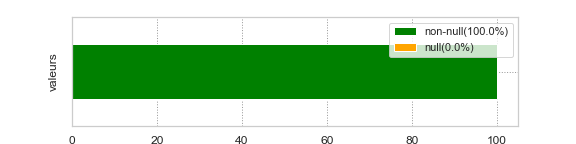

In [70]:
verifier_taille(df)

# Analyse Exploratoire

## Distributions

In [71]:
df.describe()

,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments
count,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000
mean,0.659525,0.029571,1.539683,4.151635,2.349753,2.750525,6.032730,1.188027,1.044602,2.916109
std,0.219601,0.169400,0.534249,1.280064,1.304555,1.958319,3.204851,0.829505,0.368061,2.702698
min,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000
25%,0.503616,0.000000,1.000000,4.000000,1.000000,1.000000,3.000000,1.000000,1.000000,1.000000
50%,0.686976,0.000000,2.000000,5.000000,2.000000,3.000000,6.000000,1.000000,1.000000,2.000000
75%,0.837279,0.000000,2.000000,5.000000,4.000000,4.000000,8.000000,1.000000,1.000000,4.000000
max,1.000000,1.000000,10.000000,5.000000,4.000000,6.000000,12.000000,52.000000,26.000000,24.000000


In [72]:
df.loc[df['payment_installments']==0, :]

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
54755,9925e1d7dff0d807355599dee04830ab,0.847549,0,2.0,5.0,2,1,5,2,utilidades_domesticas,credit_card,2,0,other
87722,f54cea27c80dc09bfe07b1cf1e01b845,0.814161,0,1.0,5.0,1,6,4,1,telefonia,credit_card,2,0,SP


In [73]:
df.loc[df['payment_installments']==0, 'payment_installments'] = 1
dfe.loc[df['payment_installments']==0, 'payment_installments'] = 1

In [74]:
dfe.describe()

,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
count,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.00000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000,91476.000000
mean,0.659525,0.029571,159.757882,4.151635,2.349753,2.750525,6.032730,1.188027,1.043826,2.913781,0.200523,0.760669,0.015709,0.026903,0.001924,0.004668,0.002361,0.002066,0.000219,0.000415,0.001345,0.003717,0.040830,0.029702,0.003050,0.091991,0.040546,0.096430,0.004012,0.000219,0.005072,0.000131,0.000689,0.002613,0.010943,0.007860,0.001028,0.002492,0.001968,0.001662,0.038108,0.000601,0.007499,0.002405,0.027100,0.006537,0.079387,0.019043,0.002492,0.000262,0.00

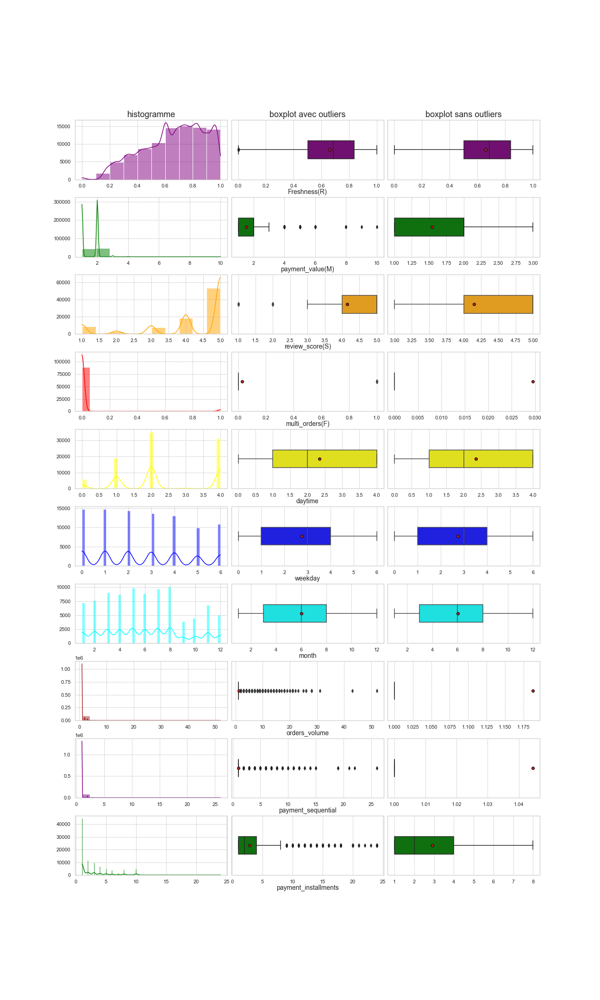

In [75]:
histo_distribution(df)

## Correlaions

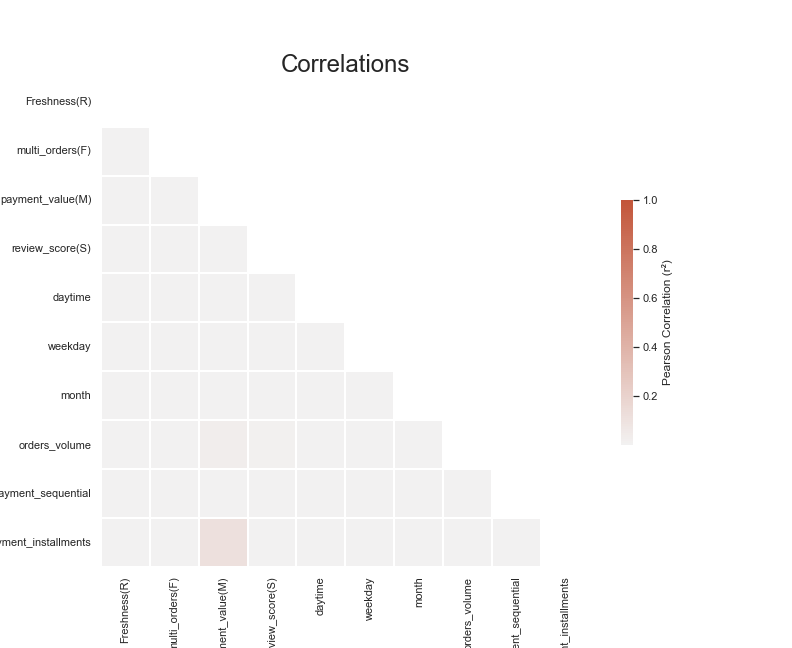

In [76]:
correlation_matrix(df)

## ANOVA

In [77]:
# X = 'payment_type'
# ANOVA(df, X, yloc=0.92, hspace=0.55, width=7, heigth=0.7)

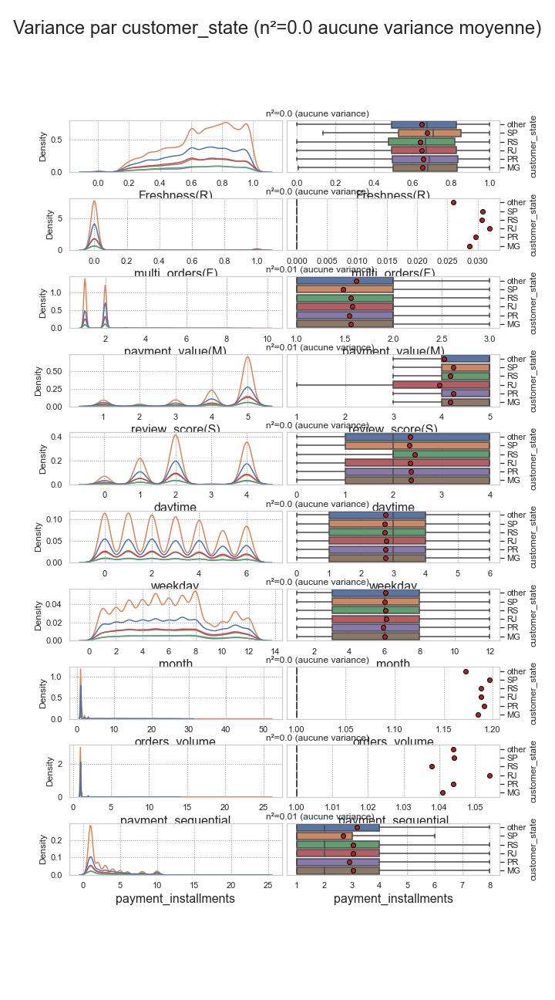

In [78]:
X = 'customer_state'
ANOVA(df, X, yloc=0.98, hspace=0.5, width=5, heigth=0.3)

In [79]:
# X = 'product_category_name'
# ANOVA(df, X, yloc=0.92, hspace=0.55, width=7, heigth=0.7)

## CHi2

p-value is:  1.907749174391085e-38
chi=219.854229, critical value=24.995790
At 0.05 level of significance, we reject the null hypotheses and accept H1. 
    They are not independent.


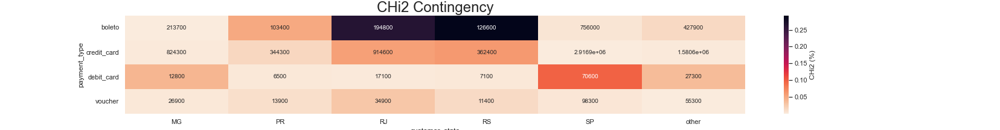

In [80]:
chi2(df, 'payment_type', 'customer_state', heigth=3, width=23)

In [81]:
dfe.head(5)

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments,ptype_boleto,ptype_credit_card,ptype_debit_card,ptype_voucher,pcategory_agro_industria_e_comercio,pcategory_alimentos,pcategory_alimentos_bebidas,pcategory_artes,pcategory_artes_e_artesanato,pcategory_artigos_de_festas,pcategory_artigos_de_natal,pcategory_audio,pcategory_automotivo,pcategory_bebes,pcategory_bebidas,pcategory_beleza_saude,pcategory_brinquedos,pcategory_cama_mesa_banho,pcategory_casa_conforto,pcategory_casa_conforto_2,pcategory_casa_construcao,pcategory_cds_dvds_musicais,pcategory_cine_foto,pcategory_climatizacao,pcategory_consoles_games,pcategory_construcao_ferramentas_construcao,pcategory_construcao_ferramentas_ferramentas,pcategory_construcao_ferramentas_iluminacao,pcategory_construcao_ferramentas_jardim,pcategory_construcao_ferramentas_seguranca,pcategory_cool_stuff,pcategory_dvds_blu_ray,pcategory_eletrodomesticos,pcategory_eletrodomesticos_2,pcategory_eletronicos,pcategory_eletroportateis,pcategory_esporte_lazer,pcategory_fashion_bolsas_e_acessorios,pcategory_fashion_calcados,pcategory_fashion_esporte,pcategory_fashion_roupa_feminina,pcategory_fashion_roupa_infanto_juvenil,pcategory_fashion_roupa_masculina,pcategory_fashion_underwear_e_moda_praia,pcategory_ferramentas_jardim,pcategory_flores,pcategory_fraldas_higiene,pcategory_industria_comercio_e_negocios,pcategory_informatica_acessorios,pcategory_instrumentos_musicais,pcategory_la_cuisine,pcategory_livros_importados,pcategory_livros_interesse_geral,pcategory_livros_tecnicos,pcategory_malas_acessorios,pcategory_market_place,pcategory_moveis_colchao_e_estofado,pcategory_moveis_cozinha_area_de_servico_jantar_e_jardim,pcategory_moveis_decoracao,pcategory_moveis_escritorio,pcategory_moveis_quarto,pcategory_moveis_sala,pcategory_musica,pcategory_papelaria,pcategory_pc_gamer,pcategory_pcs,pcategory_perfumaria,pcategory_pet_shop,pcategory_portateis_casa_forno_e_cafe,pcategory_portateis_cozinha_e_preparadores_de_alimentos,pcategory_relogios_presentes,pcategory_seguros_e_servicos,pcategory_sinalizacao_e_seguranca,pcategory_tablets_impressao_imagem,pcategory_telefonia,pcategory_telefonia_fixa,pcategory_utilidades_domesticas,cstate_MG,cstate_PR,cstate_RJ,cstate_RS,cstate_SP,cstate_other
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,141.0,5.0,1,3,5,1,1,8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,27.0,4.0,1,0,5,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0000f46a3911fa3c0805444483337064,0.227613,0,86.0,3.0,4,4,3,1,1,8,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,43.0,4.0,4,3,10,1,1,4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,196.0,5.0,4,1,11,1,1,6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0


# Components Analysis

In [82]:
df.head(5)

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,2.0,5.0,1,3,5,1,cama_mesa_banho,credit_card,1,8,SP
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,1.0,4.0,1,0,5,1,beleza_saude,credit_card,1,1,SP
2,0000f46a3911fa3c0805444483337064,0.227613,0,1.0,3.0,4,4,3,1,papelaria,credit_card,1,8,other
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,1.0,4.0,4,3,10,1,telefonia,credit_card,1,4,other
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,2.0,5.0,4,1,11,1,telefonia,credit_card,1,6,SP


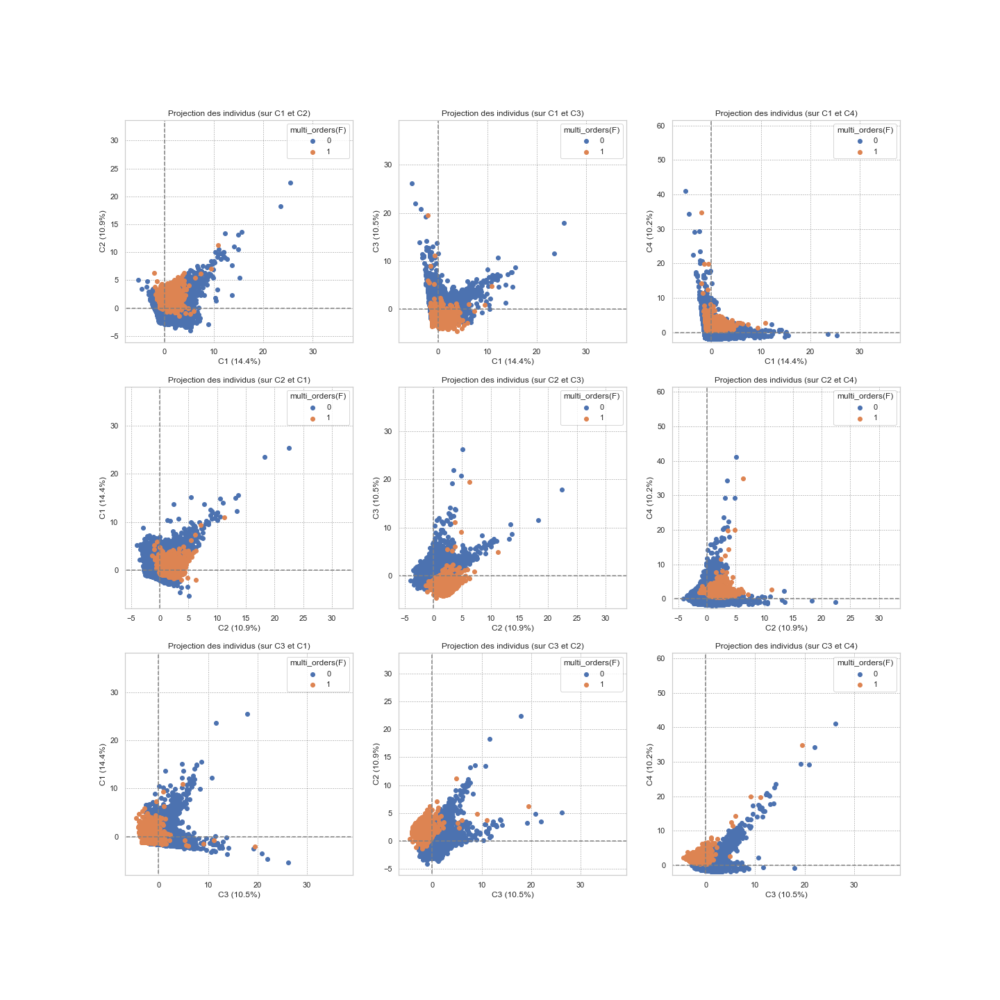

In [83]:
X = df
pca = PCA(X, 4, discrete_illustrative_var=df['multi_orders(F)'], enable_display_circles=False, enable_display_scree_plot=False)

In [84]:
ManifoldReduction3D(df, manifold = Isomap(n_neighbors=50, n_components=3, p=2), n=10000)

c:\Users\el-ha\OneDrive - Université de Poitiers\Documents\OpenClassrooms\Projets\Notebooks OC\Projets\P5\my_functions\dimensionality_reduction_functions.py:199: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(5*n_components, 5*n_components))


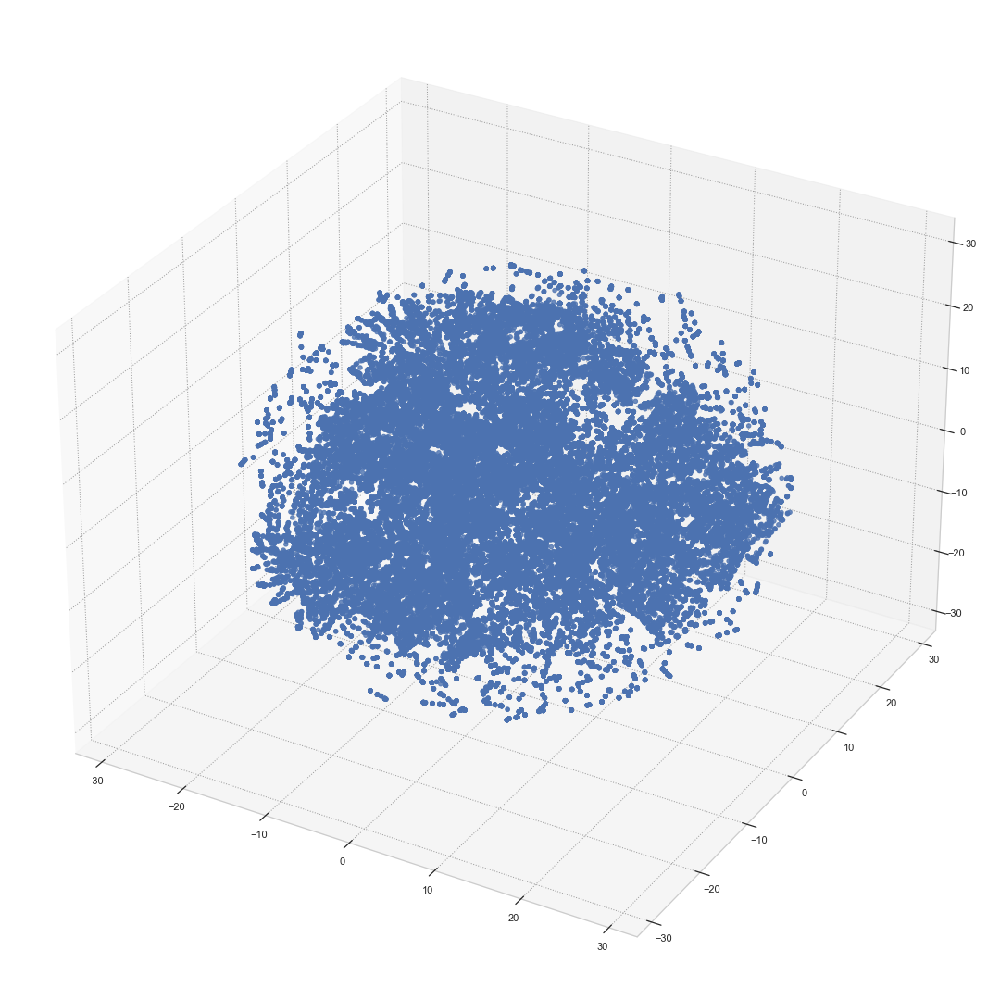

In [ ]:
ManifoldReduction3D(df,
manifold = TSNE(
    n_components=3,
    perplexity=30,
    n_iter=1000,
    init="random",
    random_state=0,
))

In [ ]:
# X = df.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=5, method='pca', heigth=10)

In [ ]:
# X = dfe.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=10, method='pca', heigth=3, width=30)

In [ ]:
# X = df.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=4, method='fa', heigth=7)

In [ ]:
# X = dfe.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=6, method='fa', heigth=3, width=28)

In [ ]:
# X = df.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=3, method='nmf', heigth=7)

In [ ]:
# X = dfe.iloc[:, 1:]
# cps = ComponentsAnalysis(X, n_comp=15, method='nmf', heigth=5, width=40)

# Clustering

In [ ]:
dfm = df.iloc[:,1:5]
dfm

,Freshness(R),multi_orders(F),payment_value(M),review_score(S)
0,0.840025,0,2.0,5.0
1,0.835723,0,1.0,4.0
2,0.227613,0,1.0,3.0
3,0.538405,0,1.0,4.0
4,0.585848,0,2.0,5.0
...,...,...,...,...
91471,0.357120,0,4.0,5.0
91472,0.623285,0,1.0,4.0
91473,0.182688,0,2.0,5.0
91474,0.828774,0,2.0,5.0


In [ ]:
df.head(5)

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,2.0,5.0,1,3,5,1,cama_mesa_banho,credit_card,1,8,SP
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,1.0,4.0,1,0,5,1,beleza_saude,credit_card,1,1,SP
2,0000f46a3911fa3c0805444483337064,0.227613,0,1.0,3.0,4,4,3,1,papelaria,credit_card,1,8,other
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,1.0,4.0,4,3,10,1,telefonia,credit_card,1,4,other
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,2.0,5.0,4,1,11,1,telefonia,credit_card,1,6,SP


In [ ]:
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score
# Sélection des scores pour l'évaluation des modèles
score_cv = 'neg_mean_squared_log_error'
scores = ['Calinski-Harabasz(Sim)', 'Davies-Bouldin(Var)', 'Silhouette']
Perfs = pd.DataFrame(columns=['Model']+scores, index=[])

def clustering(data, model, model_name, Perfs, scale='std', scores=None, hue=None):
    print('--------------------', model_name, '--------------------')
    # Nombre de clusters souhaités (taux  de compression)    
    data = data[colsOfType(data)] # garder les colonnes numériques uniquement

    # préparation des données pour le clustering
    X = data.values
    if scale=='std' or scale==None:
        X_scaled = Std_Scaled(X)
    if scale=='power':
        X_scaled = PowerTransformer_Scaled(X)

    # Clustering
    start_time = timeit.default_timer()
    model = model.fit(X_scaled)
    elapsed = timeit.default_timer() - start_time
    labels= model.labels_

    # Evaluatation
    i = len(Perfs)
    Perfs.loc[i, 'Model'] = model_name
    if scores == None:
        scores = ['Calinski-Harabasz(Sim)', 'Davies-Bouldin(Var)', 'Silhouette']
    if 'Calinski-Harabasz(Sim)' in scores:
        Perfs.loc[i, 'Calinski-Harabasz(Sim)'] =  calinski_harabasz_score(X, labels)
    if 'Davies-Bouldin(Var)' in scores:
        Perfs.loc[i, 'Davies-Bouldin(Var)'] =  davies_bouldin_score(X, labels)
    if 'Silhouette' in scores:
        Perfs.loc[i, 'Silhouette'] =  silhouette_score(X, labels)
    Perfs.loc[i, 'Time(s)'] = elapsed
    if hue != None:
        Perfs.loc[i, 'hue'] = hue
    # Convertion de type
    for score in scores:
        Perfs[score] = Perfs[score].astype('float')
    print(Perfs.loc[i])

    X = df
    pcs = PCA(X, 7, continuous_illustrative_var=labels, enable_display_circles=False, enable_display_scree_plot=False, scale=scale)
    return model

def clusteringCenters(cols, model):
    return pd.DataFrame(model.cluster_centers_, columns=cols)

## K-Means++ 

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7243.774861
Davies-Bouldin(Var)            4.639251
Silhouette                     0.006588
Time(s)                        3.831516
hue                                  df
Name: 0, dtype: object


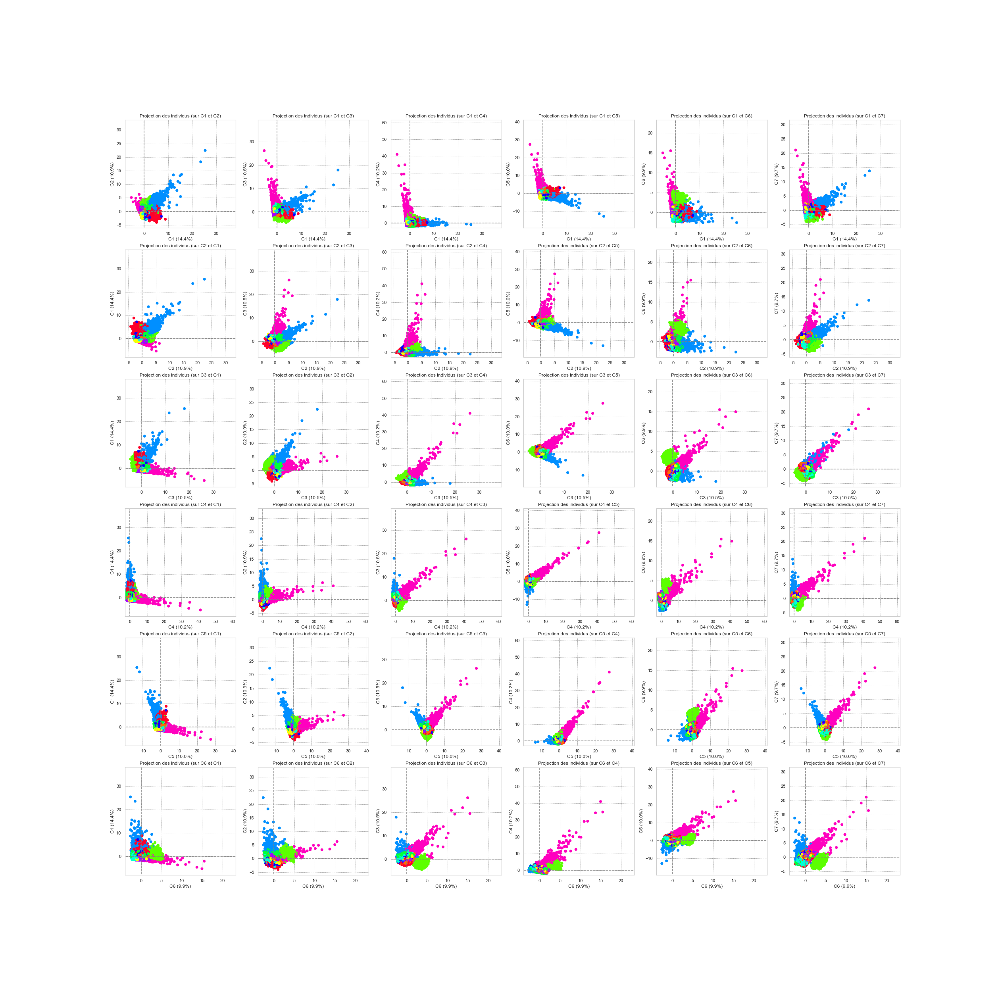

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7723.697111
Davies-Bouldin(Var)            3.446917
Silhouette                     0.079264
Time(s)                        3.486087
hue                                  df
Name: 1, dtype: object


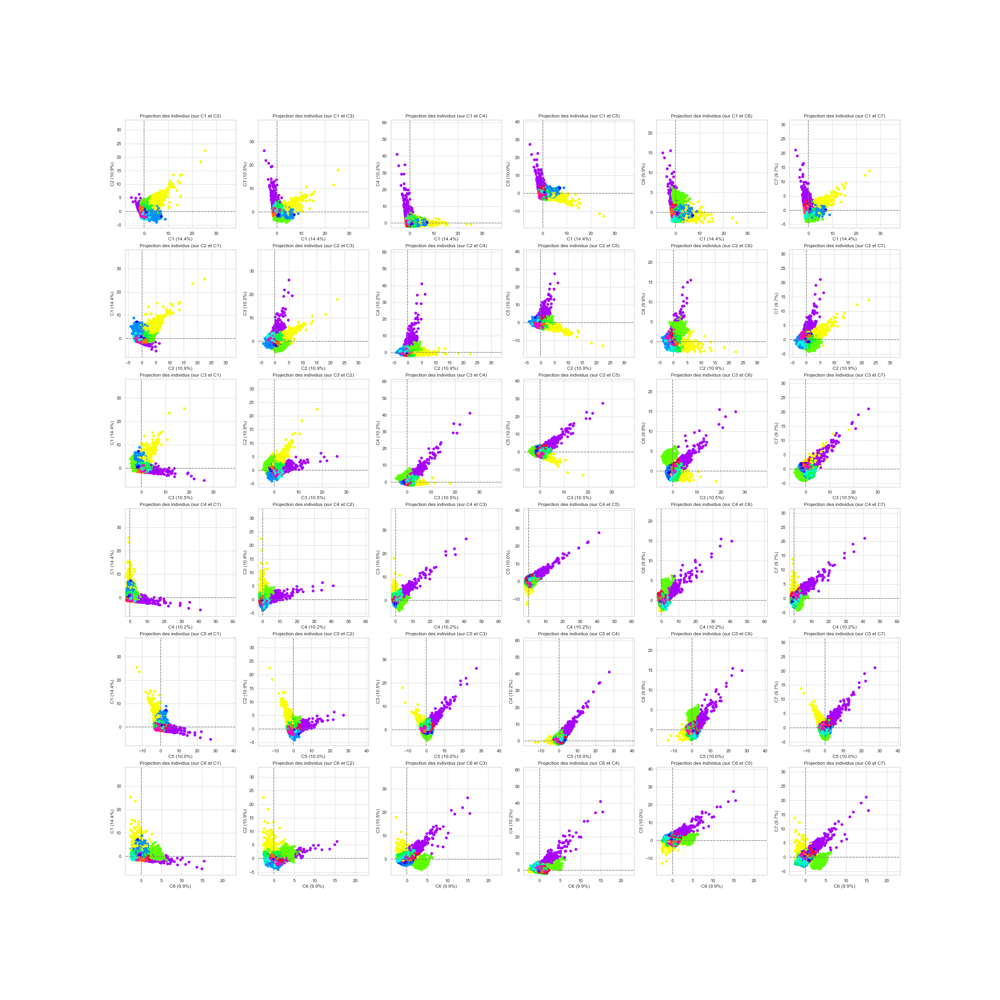

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7724.045487
Davies-Bouldin(Var)            3.446581
Silhouette                     0.079267
Time(s)                        3.167486
hue                                  df
Name: 2, dtype: object


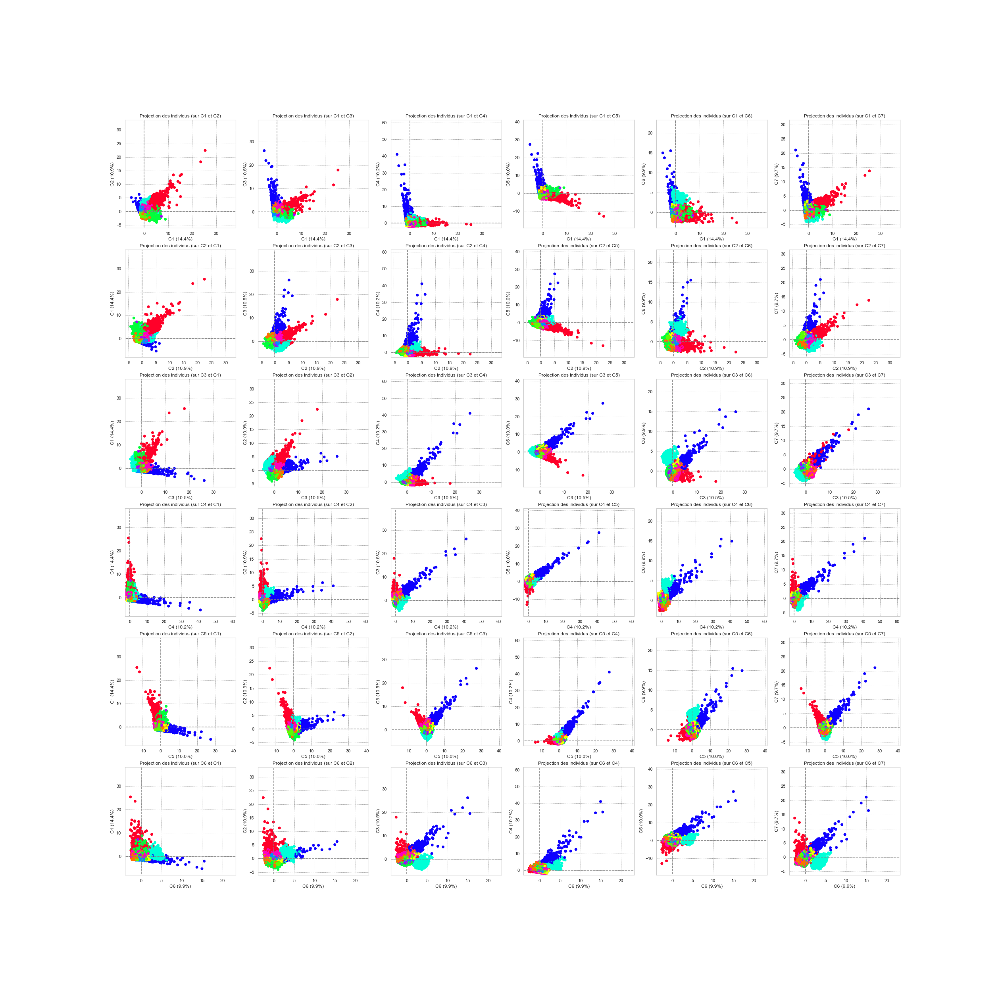

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7483.681321
Davies-Bouldin(Var)            4.009746
Silhouette                     0.029388
Time(s)                          2.7034
hue                                  df
Name: 3, dtype: object


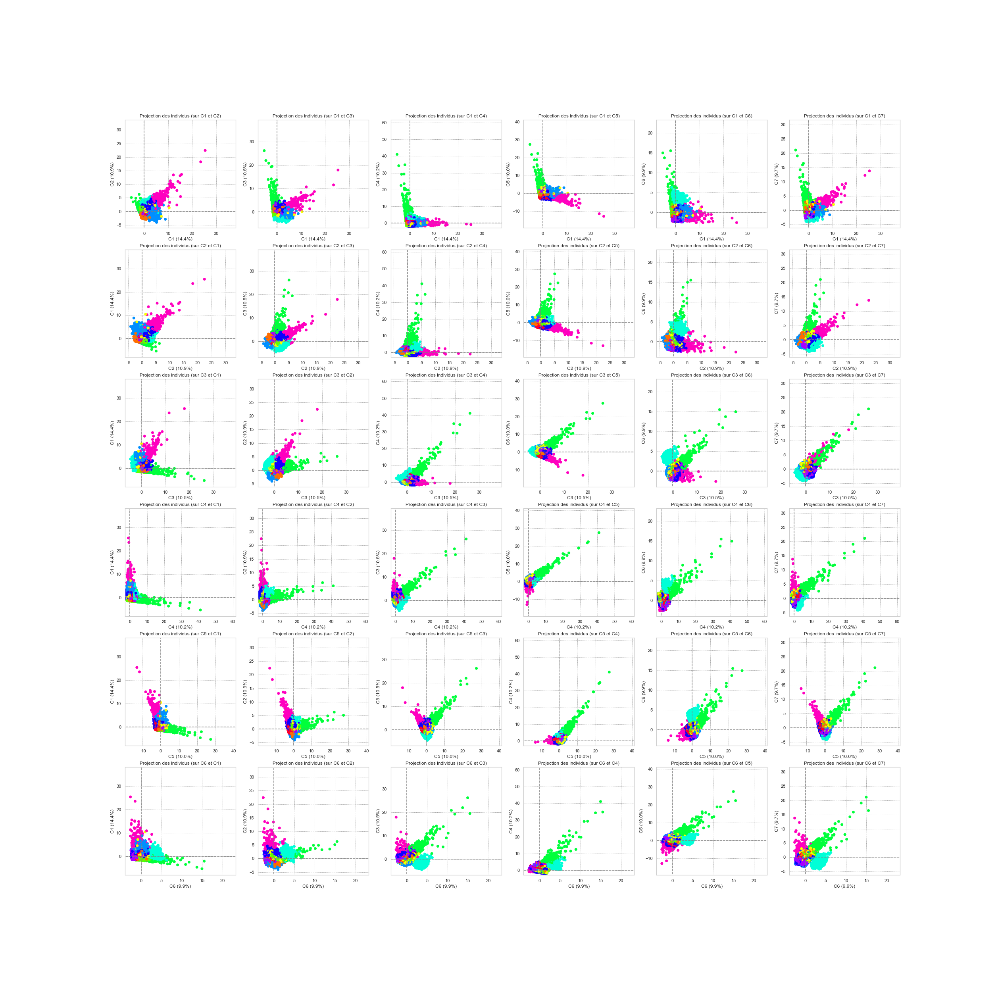

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7727.824041
Davies-Bouldin(Var)            3.418978
Silhouette                     0.079415
Time(s)                        2.926006
hue                                  df
Name: 4, dtype: object


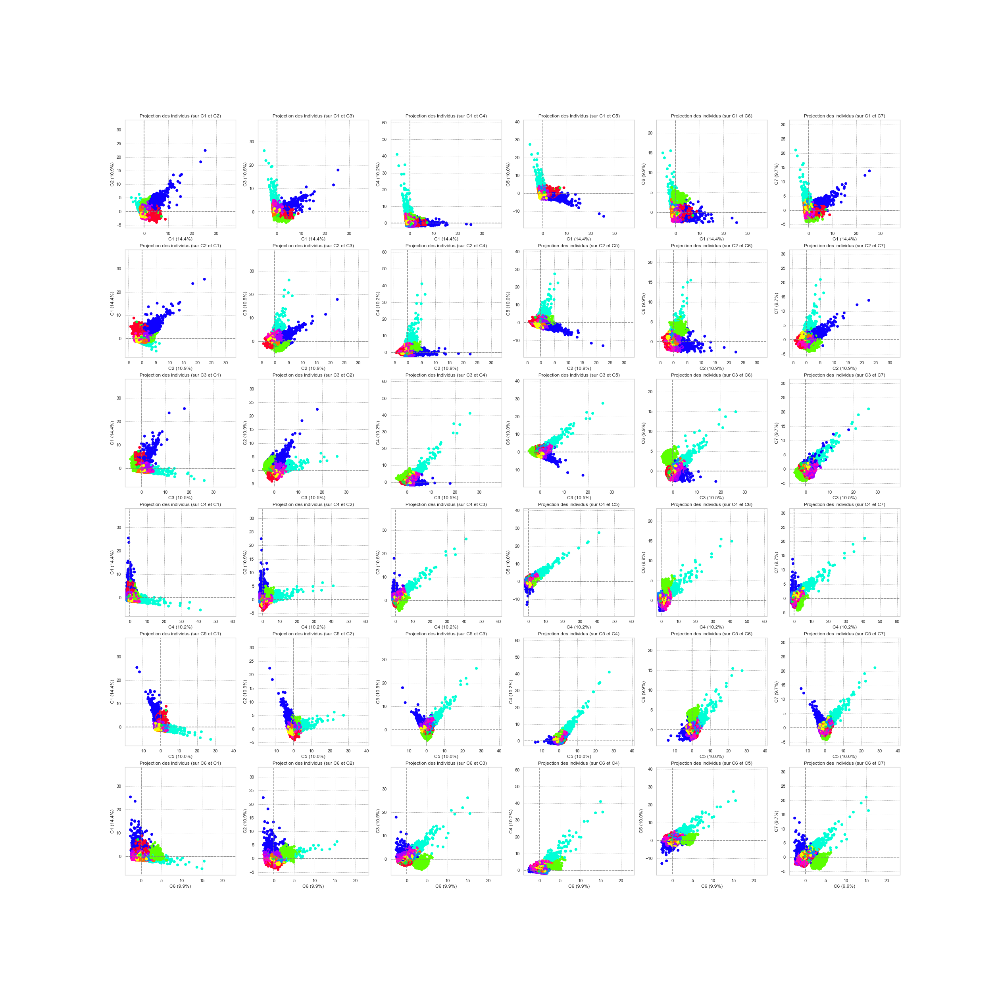

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)       7270.06676
Davies-Bouldin(Var)            4.586453
Silhouette                     0.007123
Time(s)                        2.694478
hue                                  df
Name: 5, dtype: object


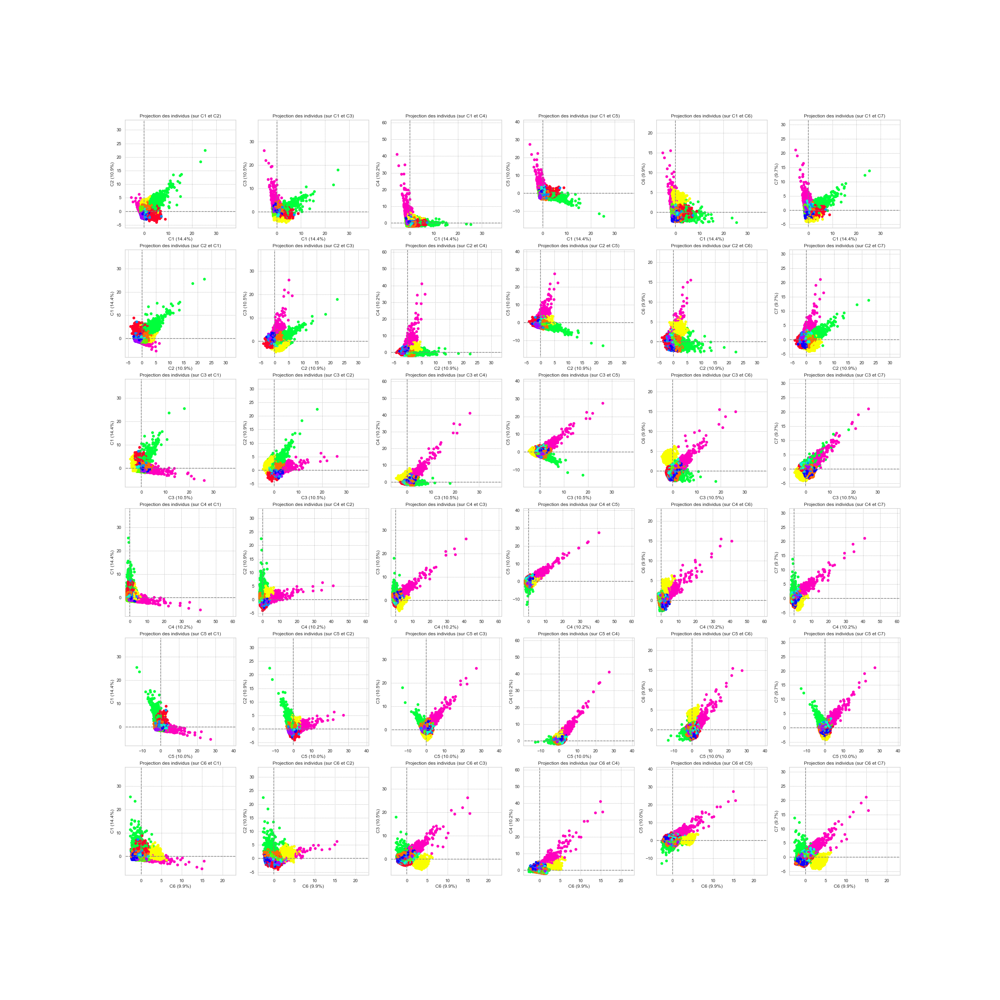

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7031.372865
Davies-Bouldin(Var)            4.121078
Silhouette                     0.068535
Time(s)                        4.142159
hue                                  df
Name: 6, dtype: object


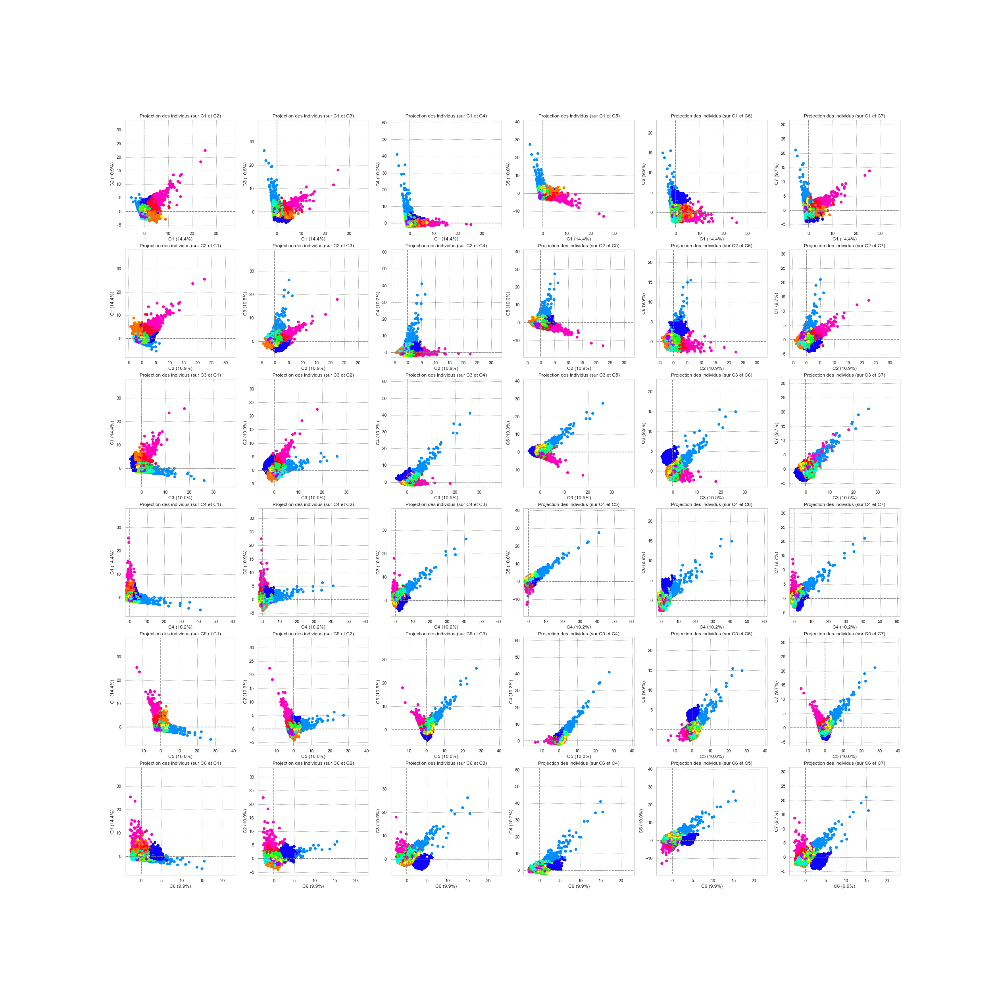

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7479.188748
Davies-Bouldin(Var)            4.034189
Silhouette                     0.029015
Time(s)                        3.051279
hue                                  df
Name: 7, dtype: object


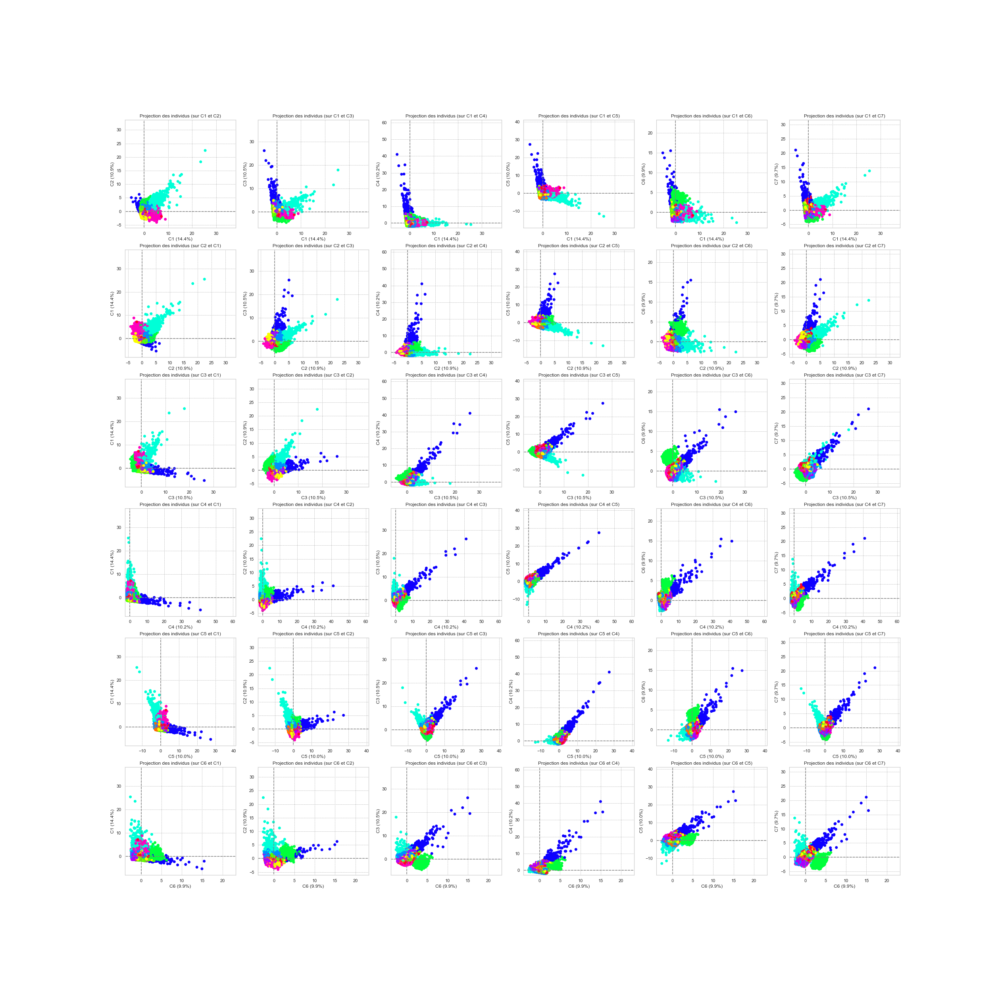

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7728.192995
Davies-Bouldin(Var)            3.419138
Silhouette                     0.079419
Time(s)                         4.54356
hue                                  df
Name: 8, dtype: object


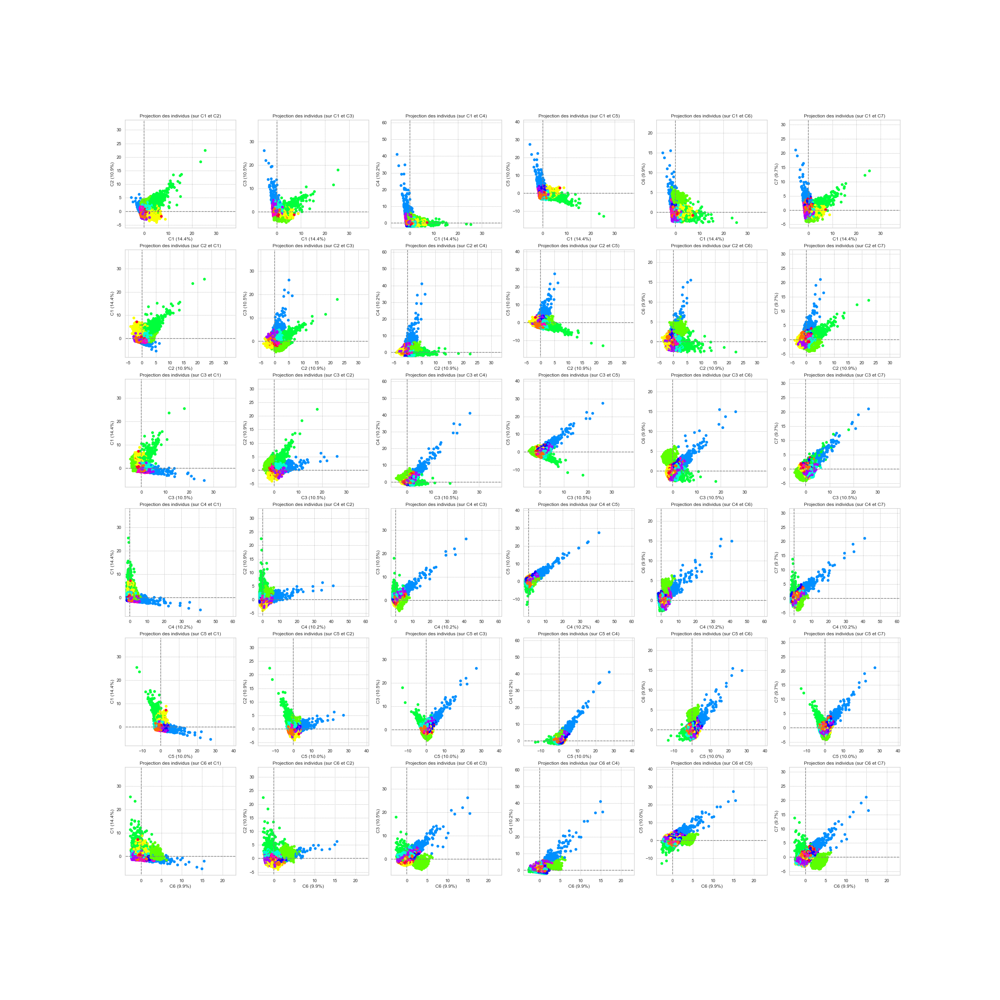

-------------------- KMeans++(std) --------------------
Model                     KMeans++(std)
Calinski-Harabasz(Sim)      7261.146903
Davies-Bouldin(Var)            4.582643
Silhouette                     0.006829
Time(s)                        2.797057
hue                                  df
Name: 9, dtype: object


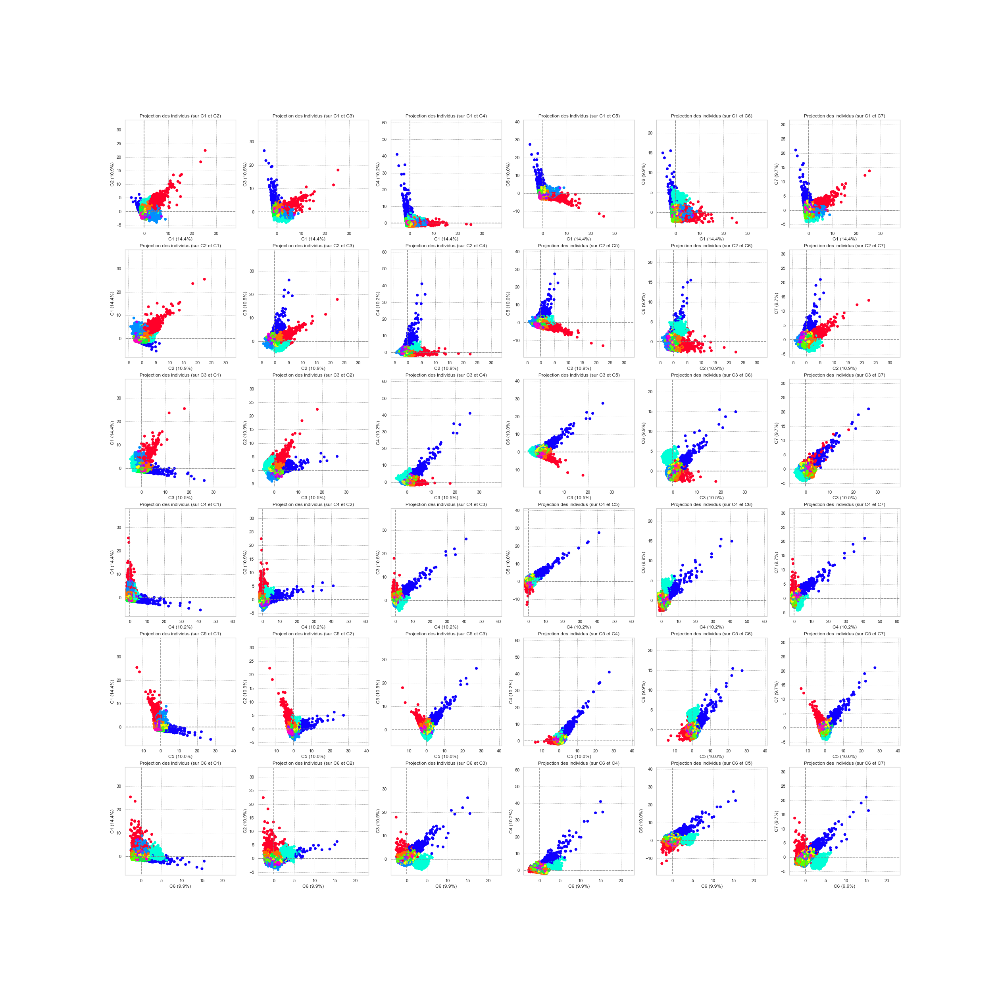

In [ ]:
from sklearn.cluster import KMeans
kmeans = []
for i in range(10):
    cls = clustering(df, KMeans(n_clusters=10, random_state=i, init='k-means++'), 'KMeans++(std)', Perfs, scale='std', scores=scores, hue='df')
    kmeans.append(cls)
cls = kmeans[0]    

In [ ]:
clusteringCenters(colsOfType(df), cls)

,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments
0,-0.084730,-0.174561,0.905180,0.076442,0.028760,0.069249,0.046154,0.011980,-0.067366,2.281501
1,0.766283,-0.174561,0.886299,0.345982,-0.001674,-0.032742,-0.470283,-0.034253,-0.058573,-0.207036
2,-0.569356,-0.174561,-1.010176,0.302000,-0.001329,0.042791,1.173411,-0.173035,-0.046988,-0.342363
3,0.116401,5.728645,0.030177,-0.046141,-0.150788,-0.075797,-0.072642,0.026223,-0.026864,0.121910
4,0.060065,-0.174561,0.018380,-2.305797,-0.004552,0.007257,-0.118529,0.111367,-0.055767,-0.136730
5,-1.726080,-0.174561,-0.187636,0.294104,0.008002,-0.006921,-0.604272,-0.107936,-0.035781,-0.246235
6,0.068058,-0.083419,0.995003,-0.692774,-0.031401,-0.045450,0.034998,7.204180,-0.066326,0.486288
7,-0.581121,-0.174561,0.895757,0.306578,0.023139,0.000869,1.184922,-0.011747,-0.047712,-0.170239
8,0.760966,-0.174561,-1.010176,0.342305,-0.004940,-0.016715,-0.480271,-0.176948,-0.058980,-0.428370
9,-0.182461,-0.024675,-0.140083,-0.084892,0.104692,0.032645,0.007461,-0.028891,9.478373,-0.548547


In [ ]:
kmeans_ARIs = np.zeros((10, 10))
for i in range(10):
    for j in range(10):
        kmeans_ARIs[i,j]=metrics.adjusted_rand_score(kmeans[i].labels_, kmeans[j].labels_)
kmeans_ARIs

c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning: overflow encountered in longlong_scalars
  return 2. * (tp * tn - fn * fp) / ((tp + fn) * (fn + tn) +
c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning: overflow encountered in longlong_scalars
  return 2. * (tp * tn - fn * fp) / ((tp + fn) * (fn + tn) +
c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning: overflow encountered in longlong_scalars
  return 2. * (tp * tn - fn * fp) / ((tp + fn) * (fn + tn) +
c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning: overflow encountered in longlong_scalars
  return 2. * (tp * tn - fn * fp) / ((tp + fn) * (fn + tn) +
c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning: overflow encountered in longlong_scalars
  return 2. * (tp * tn - fn * fp) / 

array([[  1.        ,  -7.79811952,  -7.79755186, -18.44498781,
         -7.8731346 , -18.2956037 , -41.88085224, -17.01985383,
         -7.87238952, -18.32677401],
       [ -7.79811952,   1.        ,  -8.92907404,  -9.2464051 ,
         -8.99562324,  -8.08521742, -17.67065663,  -8.7626058 ,
         -8.99519449,  -8.09713867],
       [ -7.79755186,  -8.92907404,   1.        ,  -9.24508392,
         -8.99557497,  -8.08461532, -17.66764798,  -8.76195781,
         -8.99514625,  -8.09653419],
       [-18.44498781,  -9.2464051 ,  -9.24508392,   1.        ,
         -9.34855878, -19.52316357, -81.40010779, -24.57164273,
         -9.34681958, -19.58177761],
       [ -7.8731346 ,  -8.99562324,  -8.99557497,  -9.34855878,
          1.        ,  -8.16525038, -18.0304511 ,  -8.87546414,
         -9.08876218,  -8.17740299],
       [-18.2956037 ,  -8.08521742,  -8.08461532, -19.52316357,
         -8.16525038,   1.        , -47.34357767, -17.94138037,
         -8.16445501, -19.26040572],
       [-4

## BisectingKMeans

In [ ]:
from sklearn.cluster import BisectingKMeans

bisecting_kmeans = []
for i in range(10):
    cls = clustering(df, BisectingKMeans(n_clusters=10, random_state=i, init='k-means++', bisecting_strategy='largest_cluster'), 'KMeans++(std)', Perfs, scale='std', scores=scores, hue='df')
    bisecting_kmeans.append(cls)
cls = bisecting_kmeans[0]   

ImportError: cannot import name 'BisectingKMeans' from 'sklearn.cluster' (c:\Users\el-ha\anaconda3\lib\site-packages\sklearn\cluster\__init__.py)

In [ ]:
bisecting_kmeans_ARIs = np.zeros((10, 10))
for i in range(10):
    for j in range(10):
        bisecting_kmeans_ARIs[i,j]=metrics.adjusted_rand_score(bisecting_kmeans[i].labels_, bisecting_kmeans[j].labels_)
bisecting_kmeans_ARIs

## DBSCAN

-------------------- DBSCAN(std) --------------------
Model                     DBSCAN(std)
Calinski-Harabasz(Sim)     256.725566
Davies-Bouldin(Var)            6.0113
Silhouette                  -0.125919
Time(s)                    180.151676
hue                                df
Name: 10, dtype: object


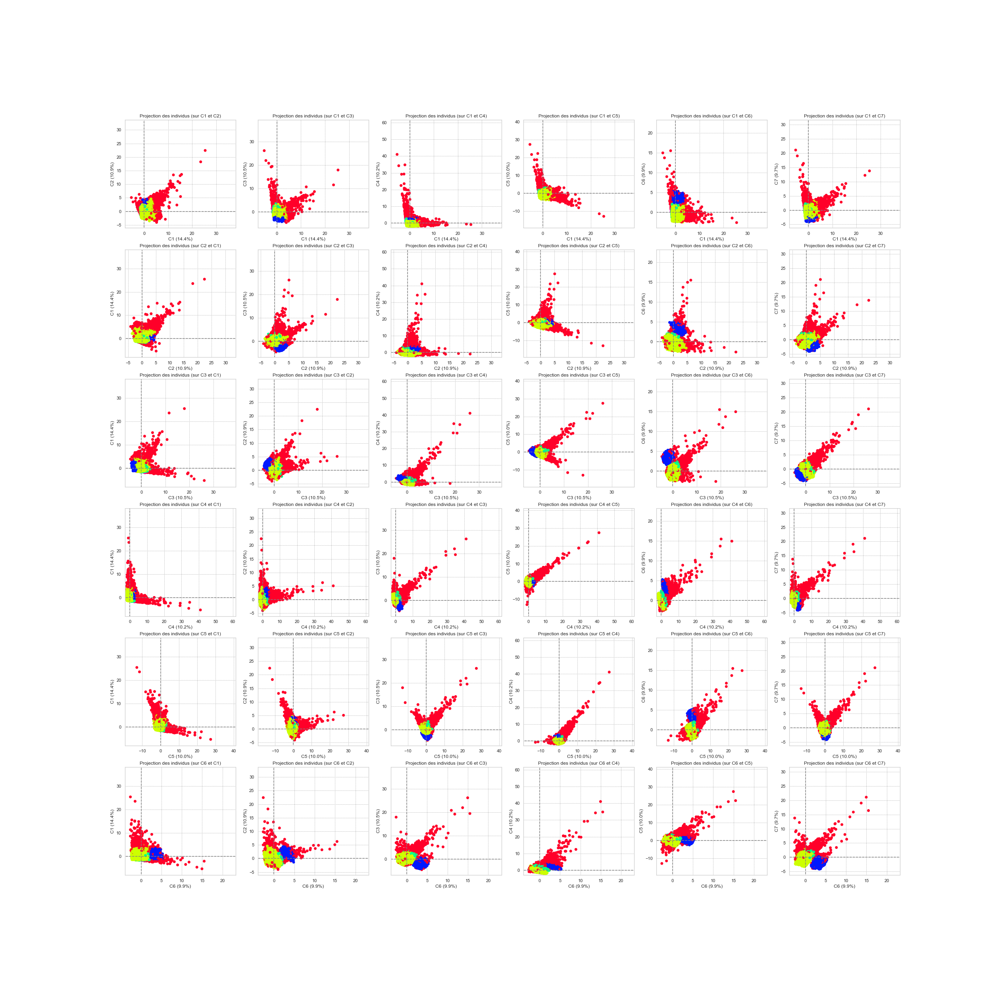

DBSCAN(eps=2, min_samples=50, n_jobs=-1)

In [99]:
from sklearn.cluster import DBSCAN

clustering(df, DBSCAN(eps=2, min_samples=50, n_jobs=-1), 'DBSCAN(std)', Perfs, scale='std', scores=scores, hue='df')

## KModes

In [100]:
from kmodes.kmodes import KModes
# Import module for data visualization
from plotnine import *
import plotnine
# Use the theme of ggplot
plt.style.use('ggplot')

In [101]:
df.iloc[:, 1:]

,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
0,0.840025,0,2.0,5.0,1,3,5,1,cama_mesa_banho,credit_card,1,8,SP
1,0.835723,0,1.0,4.0,1,0,5,1,beleza_saude,credit_card,1,1,SP
2,0.227613,0,1.0,3.0,4,4,3,1,papelaria,credit_card,1,8,other
3,0.538405,0,1.0,4.0,4,3,10,1,telefonia,credit_card,1,4,other
4,0.585848,0,2.0,5.0,4,1,11,1,telefonia,credit_card,1,6,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,0.357120,0,4.0,5.0,4,3,6,3,beleza_saude,credit_card,1,10,other
91472,0.623285,0,1.0,4.0,4,6,12,1,bebes,credit_card,1,1,other
91473,0.182688,0,2.0,5.0,2,1,2,1,automotivo,credit_card,1,1,other
91474,0.828774,0,2.0,5.0,2,2,5,1,relogios_presentes,credit_card,1,5,other


Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7
Cluster initiation: 8
Cluster initiation: 9
Cluster initiation: 10


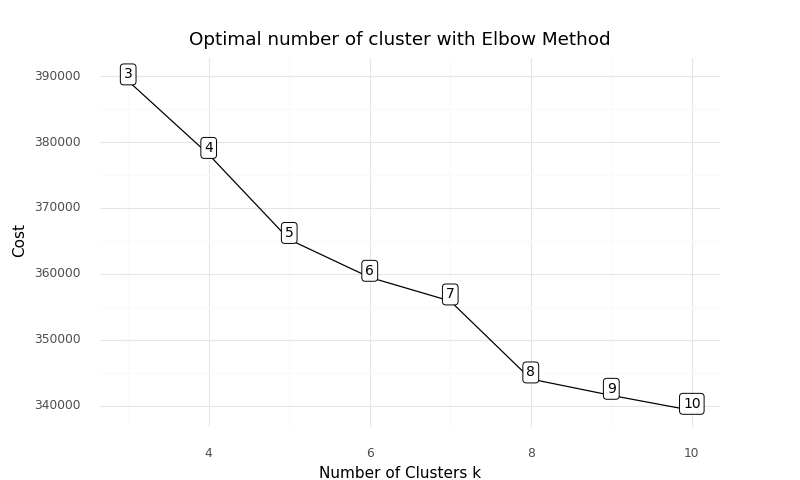

<ggplot: (132052696935)>

In [102]:
# préparation des données pour le clustering
X = df.iloc[:, 1:].values
# X_scaled = PowerTransformer_Scaled(X)
categs = ['multi_orders(F)', 'daytime', 'weekday', 'month', 'orders_volume', 'product_category_name', 'payment_type', 'customer_state']
categs = ['multi_orders(F)', 'payment_value(M)', 'daytime', 'weekday', 'month', 'review_score(S)', 'product_category_name', 'payment_type', 'customer_state']
X = df[categs].values

# Choosing optimal K
cost = []
kmodes = []
kmin = 3
kmax = 10
for cluster in range(kmin, kmax+1):
    kmodes.append(KModes(n_jobs = 4, n_clusters = cluster, init = 'Huang', random_state = 0))
    kmodes[-1].fit_predict(X)
    cost.append(kmodes[-1].cost_)
    print('Cluster initiation: {}'.format(cluster))

df_cost = pd.DataFrame({'Cluster': range(kmin, kmax+1), 'Cost': cost})# Data viz
plotnine.options.figure_size = (8, 4.8)
(
    ggplot(data = df_cost)+
    geom_line(aes(x = 'Cluster',
                  y = 'Cost'))+
    geom_point(aes(x = 'Cluster',
                   y = 'Cost'))+
    geom_label(aes(x = 'Cluster',
                   y = 'Cost',
                   label = 'Cluster'),
               size = 10,
               nudge_y = 1000) +
    labs(title = 'Optimal number of cluster with Elbow Method')+
    xlab('Number of Clusters k')+
    ylab('Cost')+
    theme_minimal()
)

In [103]:
best_kmodes = kmodes[-1]
pd.DataFrame(best_kmodes.cluster_centroids_ , columns=categs)

,multi_orders(F),payment_value(M),daytime,weekday,month,review_score(S),product_category_name,payment_type,customer_state
0,0,2.0,2,3,5,5.0,beleza_saude,credit_card,other
1,0,1.0,2,0,4,5.0,beleza_saude,boleto,SP
2,0,2.0,1,6,7,4.0,moveis_decoracao,credit_card,MG
3,0,2.0,2,1,9,5.0,cama_mesa_banho,credit_card,MG
4,0,1.0,4,6,2,5.0,informatica_acessorios,credit_card,SP
5,0,1.0,4,5,8,5.0,utilidades_domesticas,credit_card,SP
6,0,2.0,4,6,5,5.0,perfumaria,credit_card,SP
7,0,1.0,2,2,3,4.0,cama_mesa_banho,credit_card,other
8,0,1.0,4,1,3,5.0,informatica_acessorios,credit_card,SP
9,0,2.0,2,4,5,2.0,cama_mesa_banho,credit_card,SP


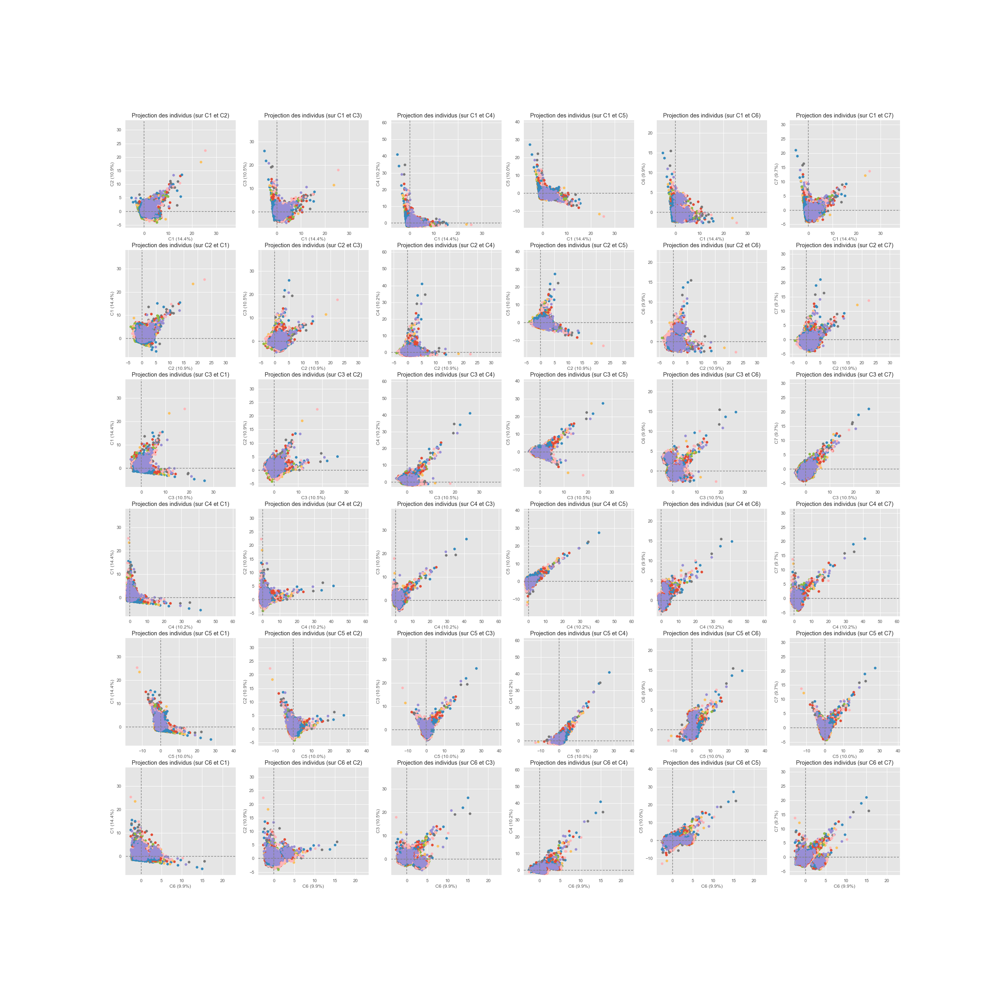

In [104]:
X = df
pcs = PCA(X, 7, discrete_illustrative_var=best_kmodes.labels_, enable_display_circles=False, enable_display_scree_plot=False, scale='std')

## KPrototype

In [105]:
from kmodes.kprototypes import KPrototypes

In [106]:
# préparation des données pour le clustering
X = df.iloc[:, 1:]
# X = dfm
# X_scaled = PowerTransformer_Scaled(X)
categs = ['multi_orders(F)', 'payment_value(M)', 'daytime', 'weekday', 'month', 'review_score(S)', 'product_category_name', 'payment_type', 'customer_state']
# categs = ['multi_orders(F)', 'product_category_name', 'payment_type', 'customer_state']
# categs = ['multi_orders(F)', 'review_score(S)']
catColumnsPos = [X.columns.get_loc(col) for col in categs]
X[colsOfType(X)] = Std_Scaled(X[colsOfType(X)], frame=True)
X[categs] = df[categs]
cols = X.columns.tolist()
X = X.values
X[0]

array([0.8219538396220226, 0, 2.0, 5.0, 1, 3, 5, -0.22667563666212087,
       'cama_mesa_banho', 'credit_card', -0.1211812562102807,
       1.881058561636459, 'SP'], dtype=object)

In [107]:
# Choosing optimal K
cost = []
kprototypes = []
kmin = 3
kmax = 10
for cluster in range(kmin, kmax+1):
    kprototypes.append(KPrototypes(n_jobs = 3, n_clusters = cluster, init = 'Huang', random_state = 0))
    kprototypes[-1].fit_predict(X, categorical = catColumnsPos)
    cost.append(kprototypes[-1].cost_)
    print('Cluster initiation: {}'.format(cluster))


Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7


c:\Users\el-ha\anaconda3\lib\site-packages\plotnine\geoms\geom_path.py:81: PlotnineWarning: geom_path: Each group consist of only one observation. Do you need to adjust the group aesthetic?


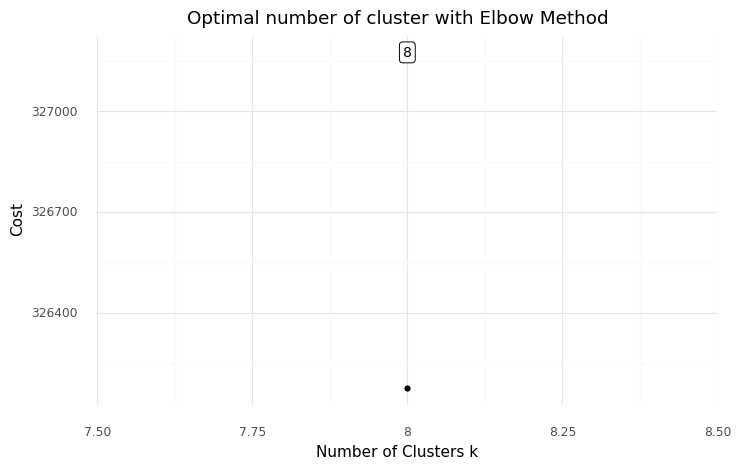

<ggplot: (159104146917)>

In [ ]:
df_cost = pd.DataFrame({'Cluster': range(kmin, kmax+1), 'Cost': cost})# Data viz
plotnine.options.figure_size = (8, 4.8)
(
    ggplot(data = df_cost)+
    geom_line(aes(x = 'Cluster',
                  y = 'Cost'))+
    geom_point(aes(x = 'Cluster',
                   y = 'Cost'))+
    geom_label(aes(x = 'Cluster',
                   y = 'Cost',
                   label = 'Cluster'),
               size = 10,
               nudge_y = 1000) +
    labs(title = 'Optimal number of cluster with Elbow Method')+
    xlab('Number of Clusters k')+
    ylab('Cost')+
    theme_minimal()
)

In [ ]:
best_kprototypes = kprototypes[-1]
pd.DataFrame(best_kprototypes.cluster_centroids_ , columns=cols)

,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,product_category_name,payment_type,payment_sequential,payment_installments,customer_state
0,-0.2809554322357118,-0.020463926892419673,17.556901255671576,-0.5945691229103387,0,2.0,4,1,4,5.0,cama_mesa_banho,voucher,SP
1,0.6967419970016618,-0.15434920310567027,-0.11078685380334904,1.2755894651932256,0,2.0,4,4,4,5.0,cama_mesa_banho,credit_card,other
2,-0.1122191789675633,-0.09441344541796631,3.116863909904338,-0.40226966232394407,0,1.0,2,1,5,5.0,cama_mesa_banho,voucher,SP
3,0.07722943889849189,2.034886212501609,-0.10926727500463038,-0.019188000824939877,0,2.0,2,2,11,5.0,moveis_decoracao,credit_card,SP
4,0.7234058107070193,-0.1912174503712275,-0.12118125621022743,-0.5088806599965346,0,1.0,2,0,8,5.0,beleza_saude,credit_card,SP
5,0.050566843362611524,8.412718032478674,-0.059967364329441775,0.5023559048777794,0,2.0,2,0,8,5.0,cama_mesa_banho,credit_card,SP
6,-0.9928833291213237,-0.18546678657113985,-0.12118125621022593,-0.40039395761125623,0,1.0,2,1,11,5.0,esporte_lazer,credit_card,SP
7,-0.9169371340821435,-0.06275910504842279,-0.09381673351281153,1.9925772234087122,0,2.0,2,3,11,5.0,cama_mesa_banho,credit_card,SP


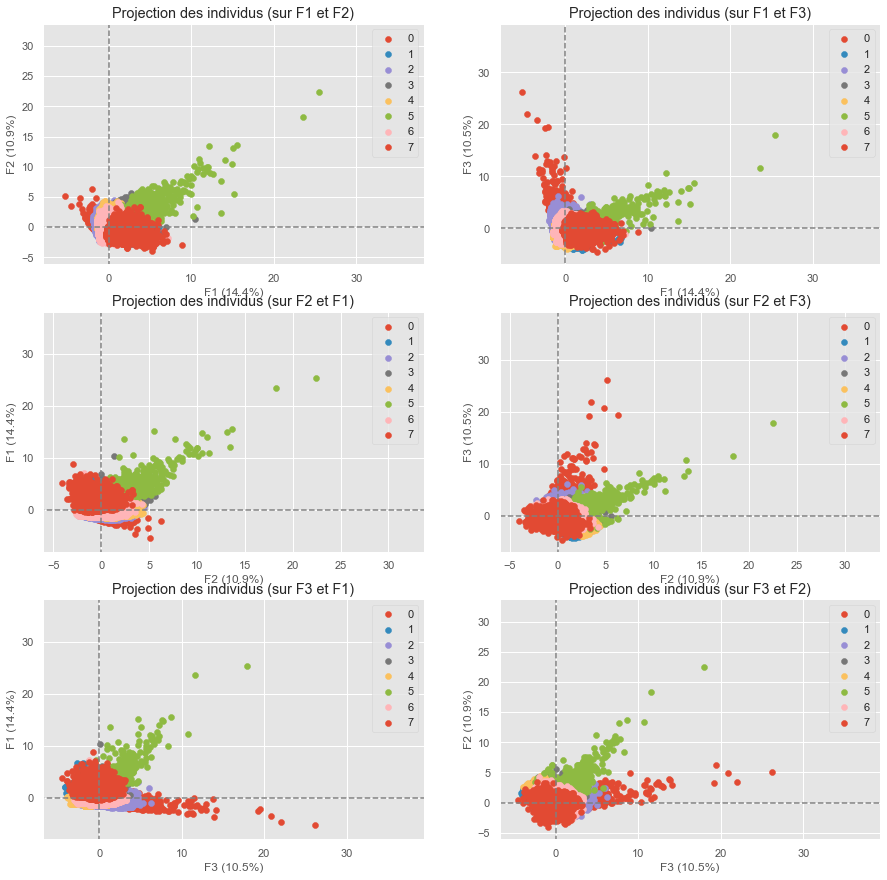

In [ ]:
X = df
pcs = PCA(X, 7, discrete_illustrative_var=best_kprototypes.labels_, enable_display_circles=False, enable_display_scree_plot=False, scale='std')

## Evaluation

In [ ]:
display_scores(Perfs, hue='Data')

TypeError: display_scores() missing 1 required positional argument: 'y'

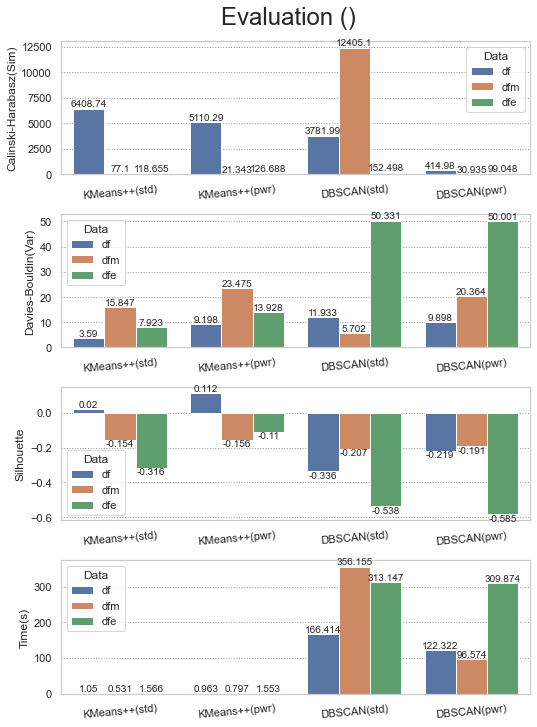

In [ ]:
# display_scores(Perfs, hue='Data')